In [1]:
import os
import glob
import numpy as np
import matplotlib.pyplot as plt
import cv2
import sys
from tqdm import tqdm
import time
sys.path.append('../../../src')

import torch
import torch.nn.functional as F
from torch import tensor
from torch import nn
from torch import optim
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from sklearn.preprocessing import Normalizer

from common import common, transform, json
from common.json import IA_FORMAT, START_IDX
from common.functions import gauss, cos_similarity, standardize
from common.default import PASSING_DEFAULT
from display.display import display
from individual_activity.individual_activity import IndividualActivity

In [2]:
device_idx = 2
device = f'cuda:{device_idx}' if torch.cuda.is_available() else 'cpu'
device

'cuda:2'

# Indivisual Activity をロード

In [3]:
data_settings = [
    {'room_num': '02', 'date': '20210903', 'option': 'passing'},
    {'room_num': '08', 'date': '20210915', 'option': 'passing'},
    {'room_num': '09', 'date': '20210706', 'option': 'passing'}
]

In [4]:
# homography
def get_homo(room_num):
    field_path = os.path.join(common.data_dir, '{}/field.png'.format(room_num))
    field_raw = cv2.imread(field_path)
    p_video = common.homo[room_num][0]
    p_field = common.homo[room_num][1]
    homo = transform.Homography(p_video, p_field, field_raw.shape)
    return homo

In [5]:
def load_individuals(json_data, prefix, homo):
    individuals = {}
    for data in json_data:
        label = prefix + str(data[IA_FORMAT[0]])
        frame_num = data[IA_FORMAT[1]]
        tracking_point = data[IA_FORMAT[2]]
        keypoints = data[IA_FORMAT[3]]

        if label not in individuals:
            ia = IndividualActivity(label, homo)
            individuals[label] = ia
        else:
            ia = individuals[label]

        ia.tracking_points[frame_num] = tracking_point
        ia.keypoints[frame_num] = keypoints
        for f in IA_FORMAT[START_IDX:]:
            ia.indicator_dict[f][frame_num] = data[f]
            
    return individuals

In [6]:
individuals = {}
for setting in data_settings:
    print(setting)
    room_num = setting['room_num']
    date = setting['date']
    opt = setting['option']
    
    homo = get_homo(room_num)
    
    if opt is None:
        dir_path = f'{common.data_dir}/{room_num}/{date}/*'
    else:
        dir_path = f'{common.data_dir}/{room_num}/{date}/{opt}/*'
    dirs = glob.glob(dir_path)
    dirs = sorted(dirs)[:-1]  # delete make_csv.csv
    
    for path in tqdm(dirs):
        path = f'{path}/json/individual_activity.json'
        json_data = json.load(path)
        prefix = common.split_path(path)[-6] + '_' + common.split_path(path)[-3] + '_'  # room-num_date_
        individuals.update(load_individuals(json_data, prefix, homo))

{'room_num': '02', 'date': '20210903', 'option': 'passing'}


100%|██████████| 23/23 [00:03<00:00,  6.56it/s]


{'room_num': '08', 'date': '20210915', 'option': 'passing'}


100%|██████████| 41/41 [00:03<00:00, 10.33it/s]


{'room_num': '09', 'date': '20210706', 'option': 'passing'}


100%|██████████| 9/9 [00:01<00:00,  5.18it/s]


# 特徴量抽出とデータ生成

In [7]:
def extract_features(frame_num, label1, label2, individuals):
    individual1 = individuals[label1]
    pos1 = individual1.get_indicatorcator('position', frame_num)
    kps1 = individual1.keypoints[frame_num]
    if pos1 is None or kps1 is None:
        return None
    
    individual2 = individuals[label2]
    pos2 = individual2.get_indicatorcator('position', frame_num)
    kps2 = individual2.keypoints[frame_num]
    if pos2 is None or kps2 is None:
        return None
    
    # ポジション間の距離
    norm = np.linalg.norm(np.array(pos1) - np.array(pos2), ord=2)
    if norm < 50 or 300 < norm:
        # norm が範囲外の時はデータに加えない
        # plot.ipynb の分布から決定した
        return None
    
    features = []
    for p1 in kps1:
        row = []
        for p2 in kps2:
            norm = np.linalg.norm(np.array(p1) - np.array(p2))
            row.append(norm)
        features.append(row)
    
    return features

In [8]:
x_dict = {}
y_dict = {}
for setting in data_settings:
    room_num = setting['room_num']
    date = setting['date']
    opt = setting['option']
    
    dirs = sorted(glob.glob(f'{common.data_dir}/{room_num}/{date}/{opt}/*'))
    if dirs[-1].endswith('make_csv.csv'):
        dirs = dirs[:-1]

    for path in dirs:
        file_num = common.split_path(path)[-1]
        csv_path = f'{path}/csv/data.csv'
        csv_data = np.loadtxt(csv_path, delimiter=',', dtype=int, skiprows=1)

        for row in tqdm(csv_data, desc=f'{room_num}, {date}, {file_num}'):
            frame_num = row[0]
            label1 = f'{room_num}_{file_num}_{row[1]}'
            label2 = f'{room_num}_{file_num}_{row[2]}'

            features = extract_features(frame_num, label1, label2, individuals)
            key = f'{room_num}_{file_num}_{row[1]}_{row[2]}'

            if key not in x_dict:
                x_dict[key] = []
                y_dict[key] = []

            x_dict[key].append(features)
            y_dict[key].append(row[3])

09, 20210706, 09: 100%|██████████| 3701/3701 [00:04<00:00, 862.02it/s] 


## nanを穴埋めする

In [9]:
def fill_nan(x_lst, y_lst, window=3):
    # None を飛ばす
    for i in range(len(x_lst)):
        if x_lst[i] is not None:
            break
    
    pre_x = x_lst[i]
    pre_y = y_lst[i]
    
    copy_x_lst = []
    copy_y_lst = []
    for x, y in zip(x_lst[i + 1:], y_lst[i + 1:]):
        if x is not None:
            if True in np.isnan(x):
                x = np.where(np.isnan(x), pre_x, x).copy()
            copy_x_lst.append(x)
            copy_y_lst.append(y)
            pre_x = x.copy()
            pre_y = y
        else:
            # 前のフレームからコピー
            copy_x_lst.append(pre_x)
            copy_y_lst.append(pre_y)
            
    return np.nan_to_num(copy_x_lst), copy_y_lst

#     # 残ったnanは移動平均で穴埋め
#     ma_x_lst = []
#     ma_y_lst = []
#     for i in range(0, len(copy_x_lst) - window + 1):
#         if copy_x_lst[i] is None:
#             print(copy_x_lst[i:i + window])
#         means = np.nanmean(copy_x_lst[i:i + window], axis=0)
#         for x, y in zip(copy_x_lst[i:i + window], copy_y_lst[i:i + window]):
#             if True in np.isnan(x):
#                 x = np.where(np.isnan(x), means, x).copy()

#             if len(ma_x_lst) <= i + window and True not in np.isnan(x):
#                 # nanを埋めきったデータのみ追加
#                 ma_x_lst.append(x)
#                 ma_y_lst.append(y)

#     return  np.array(ma_x_lst), np.array(ma_y_lst)


x_dict_fill_nan = {}
y_dict_fill_nan = {}
for key, x_lst in x_dict.items():
    y_lst = y_dict[key]
    x_lst, y_lst = fill_nan(x_lst, y_lst, window=3)
    # x_lst = np.nan_to_num(x_lst)
    if len(x_lst) > 0:
        x_dict_fill_nan[key] = x_lst
        y_dict_fill_nan[key] = y_lst

## 標準化

In [10]:
x_all = []
for x_lst in x_dict_fill_nan.values():
    x_all += x_lst.tolist()

mean = np.mean(x_all)
std = np.std(x_all)
print(mean, std)

x_dict_std = {}
y_dict_std = y_dict_fill_nan
for key, x_lst in x_dict_fill_nan.items():
    x_lst = (np.array(x_lst) - mean) / std
    x_dict_std[key] = x_lst

241.3356749394471 180.26530149370228


## プロット

02_01_4_17


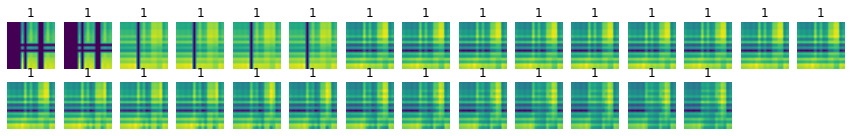

02_02_1_2


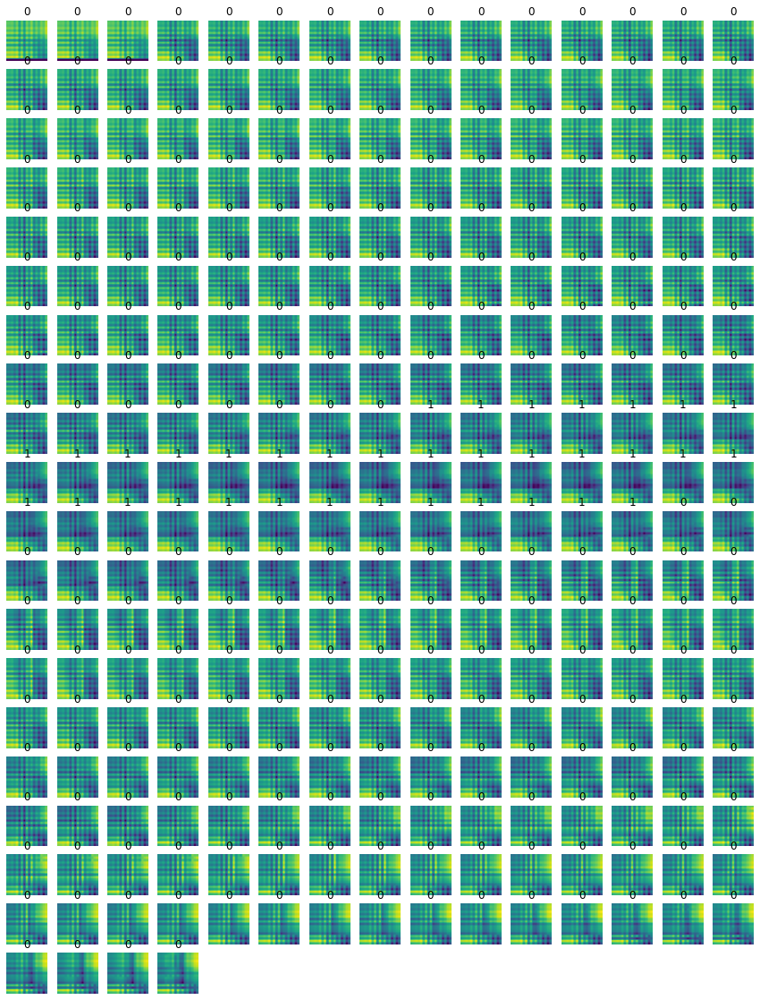

02_02_2_4


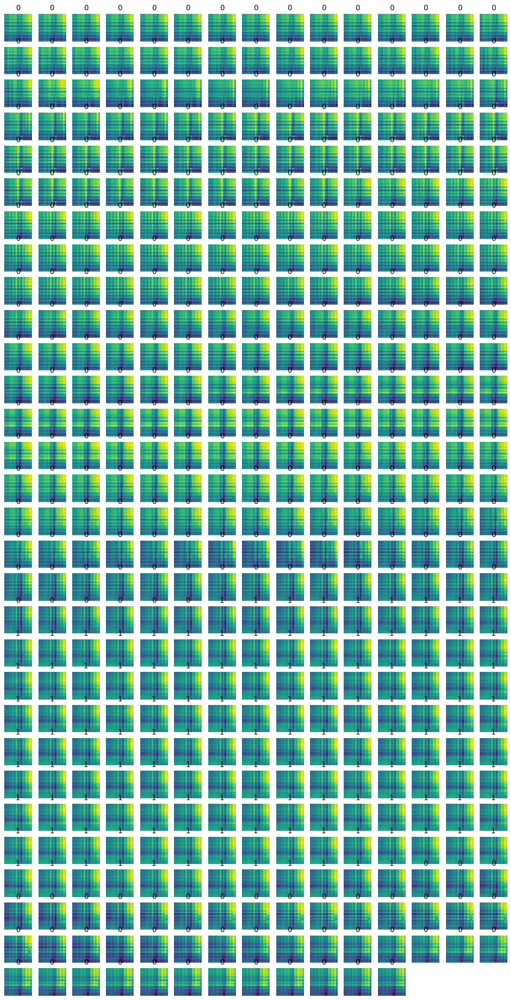

02_03_1_4


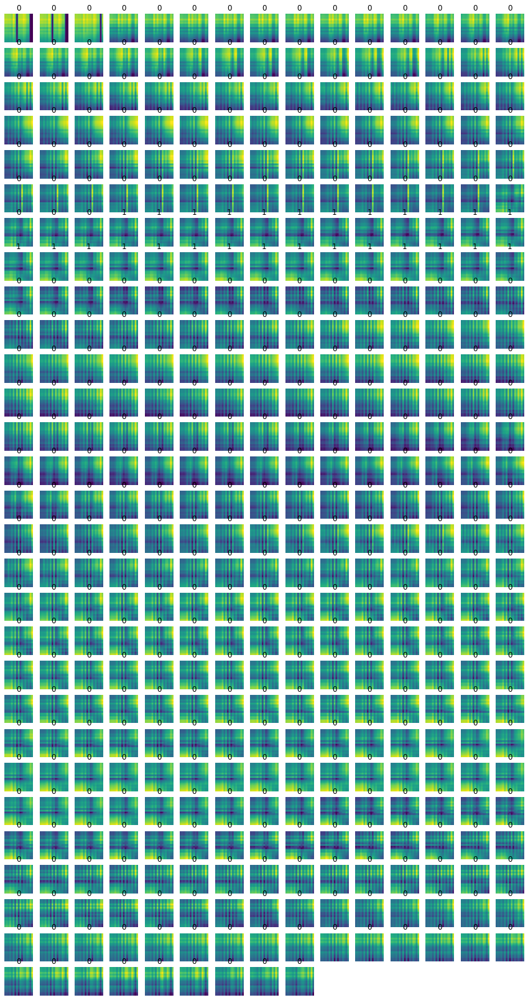

02_05_0_4


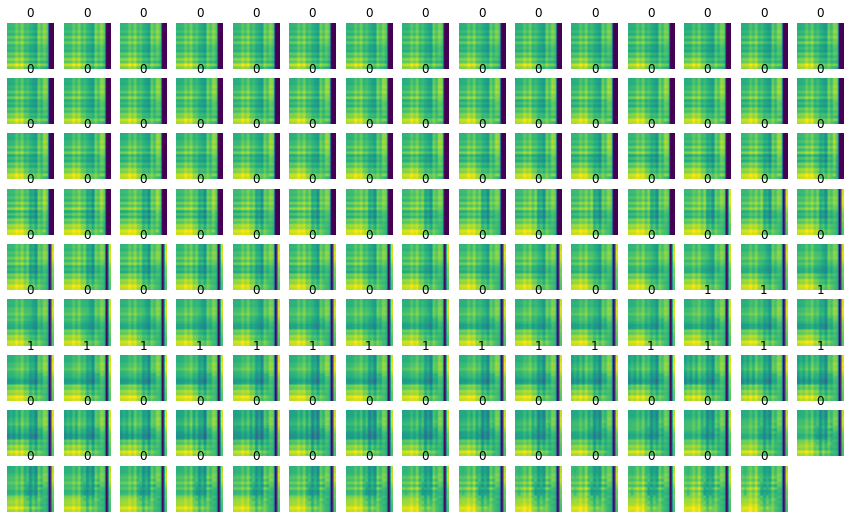

02_06_0_4


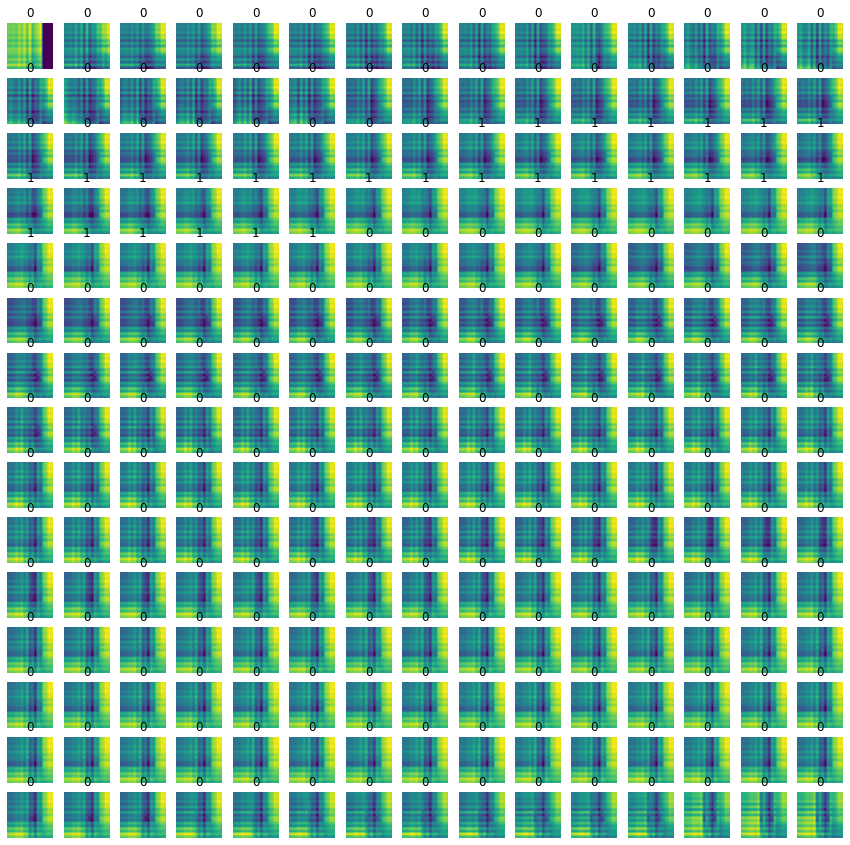

02_07_1_8


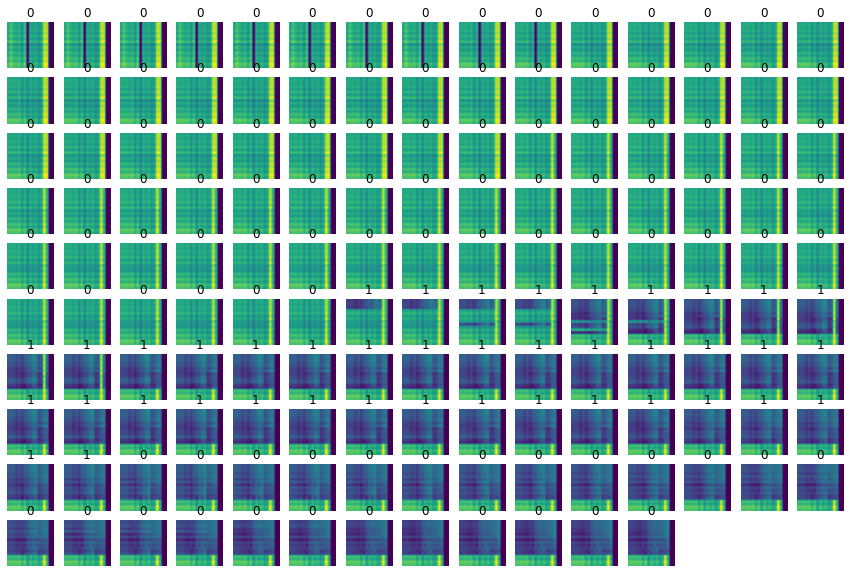

02_09_0_9


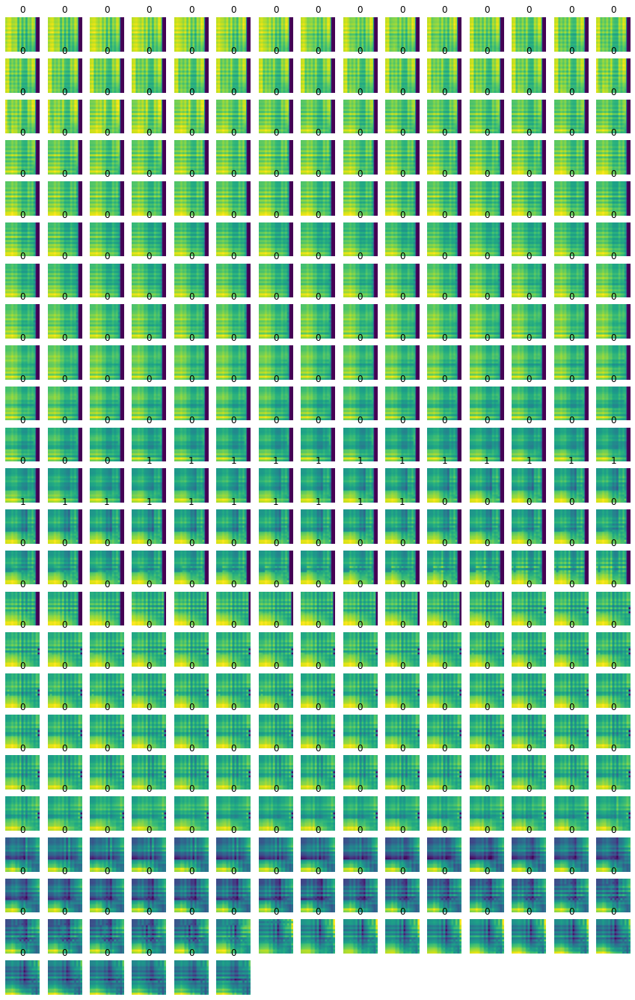

02_10_4_13


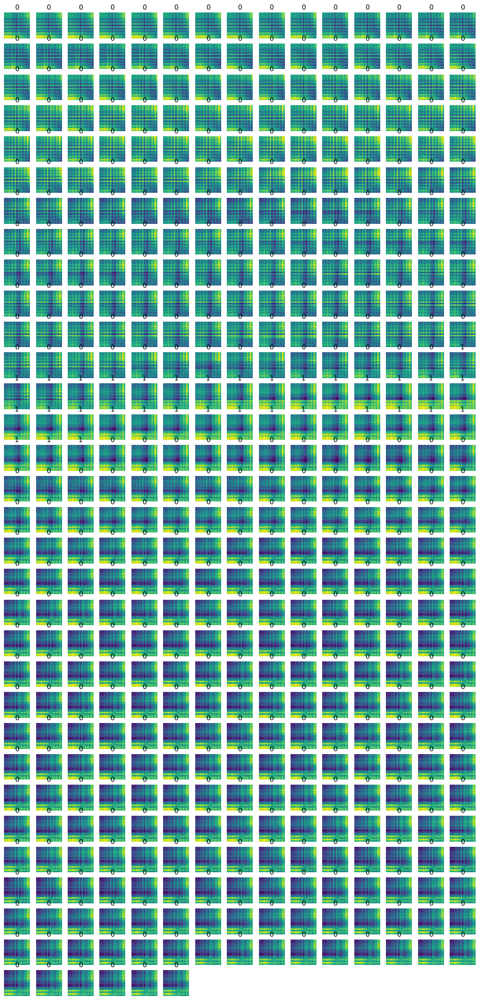

02_11_2_6


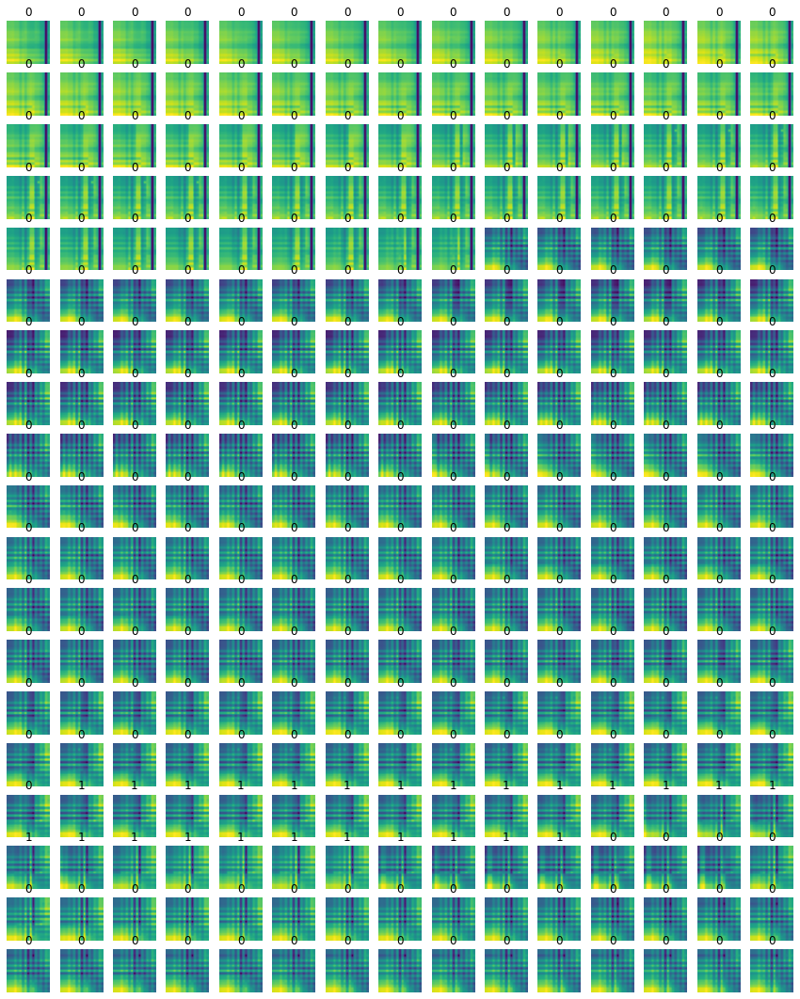

02_12_4_7


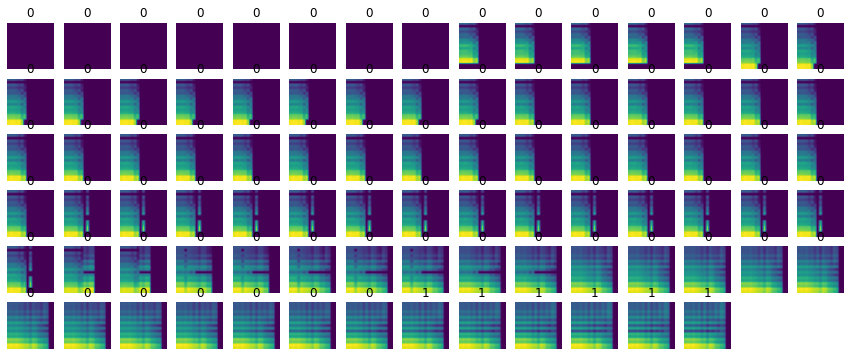

02_13_1_9


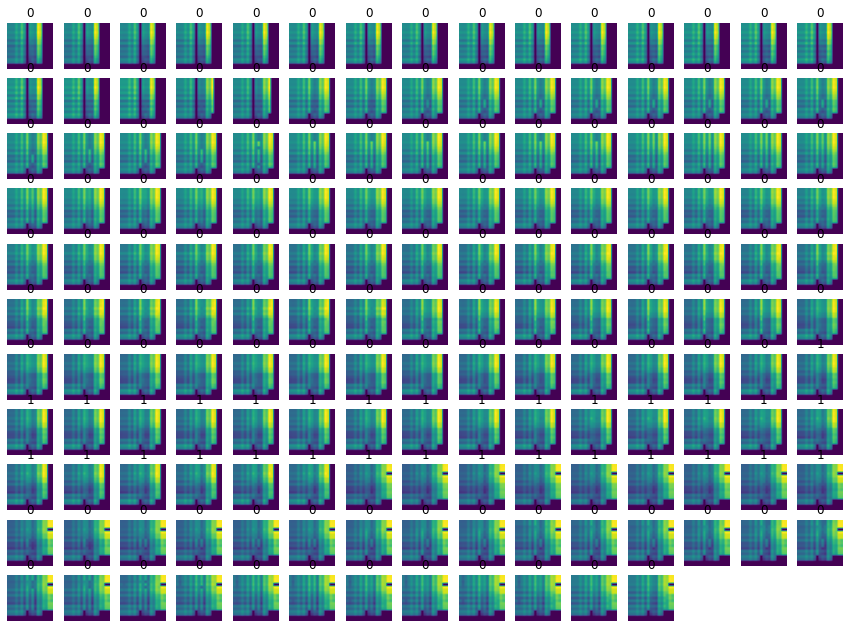

02_15_9_21


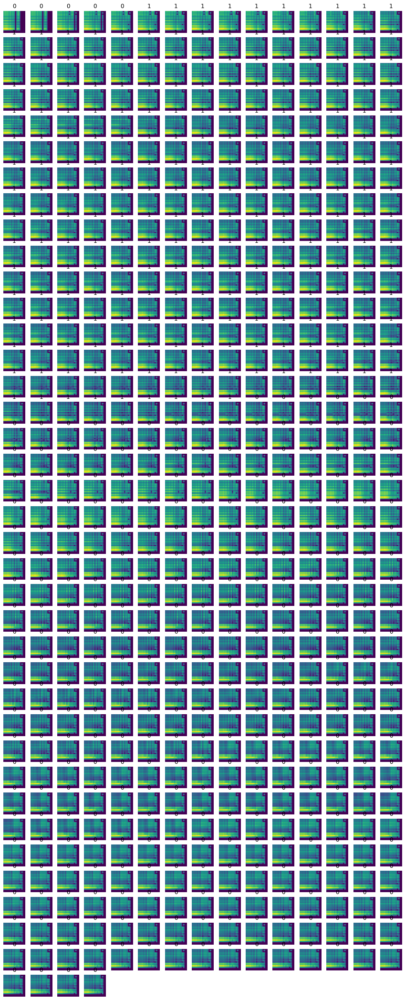

02_18_1_10


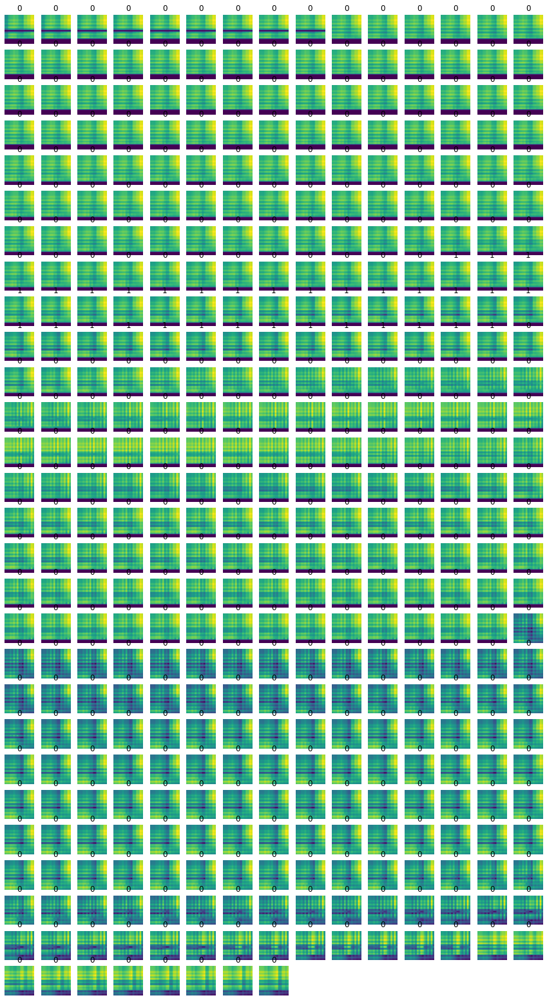

02_19_0_4


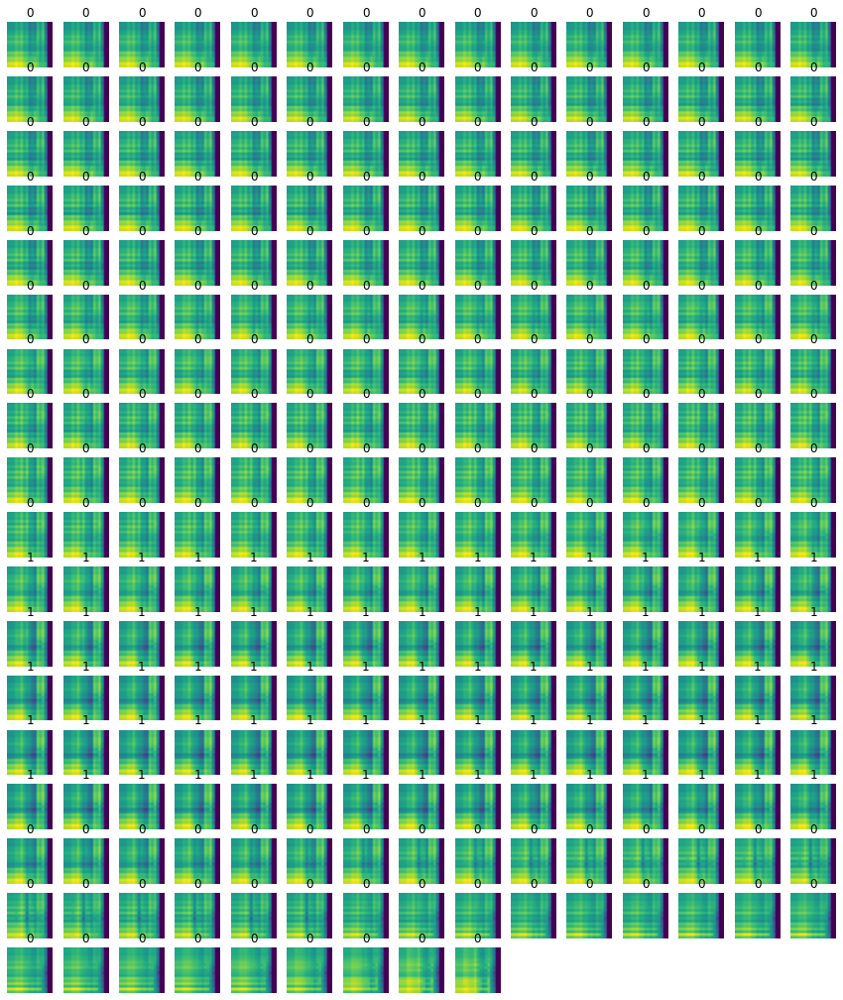

02_20_2_8


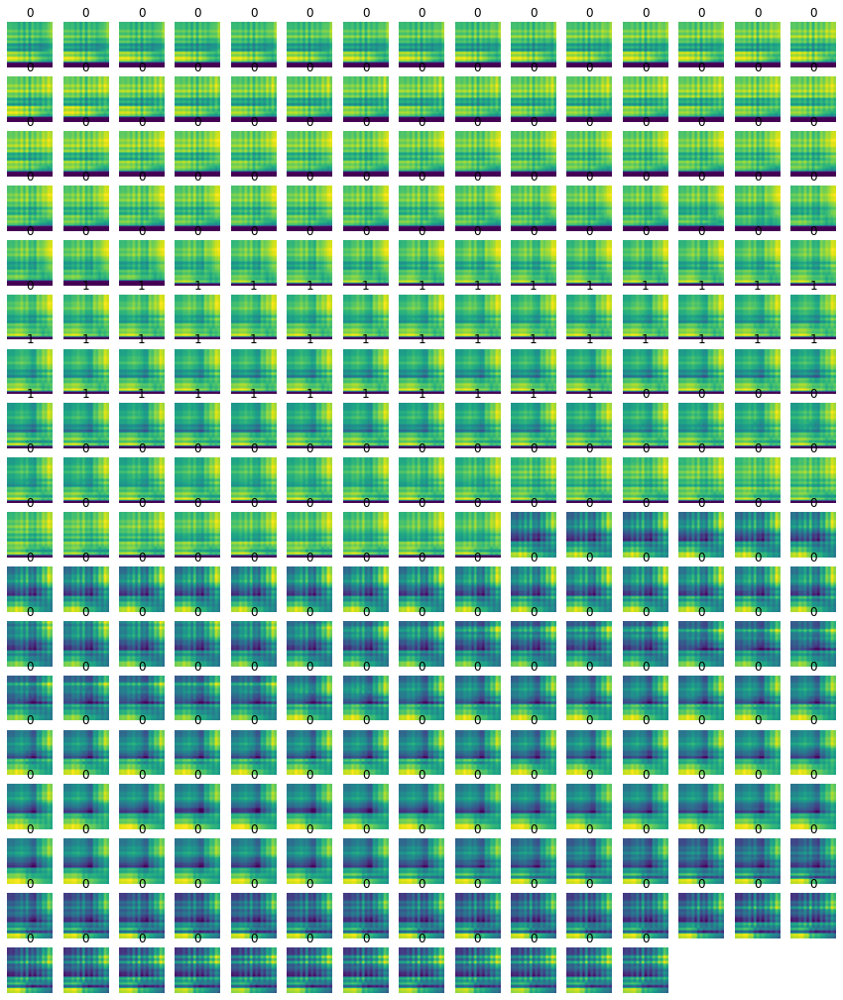

02_21_6_10


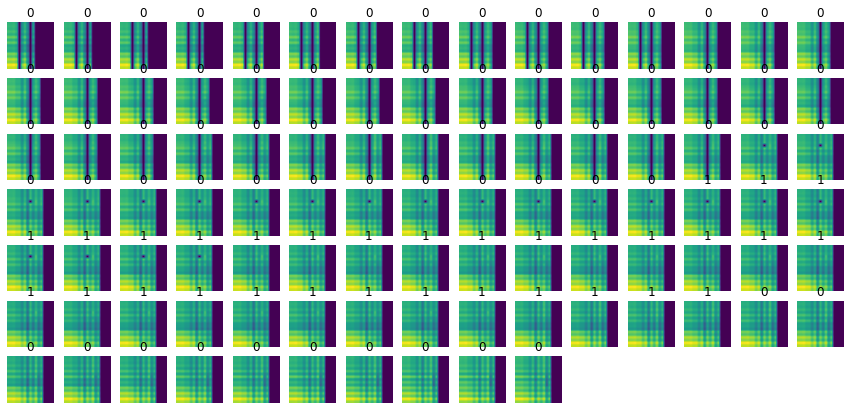

02_22_0_5


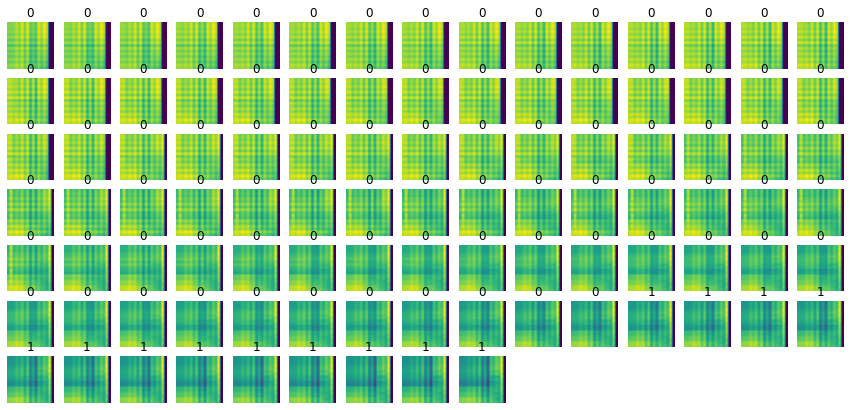

02_23_3_14


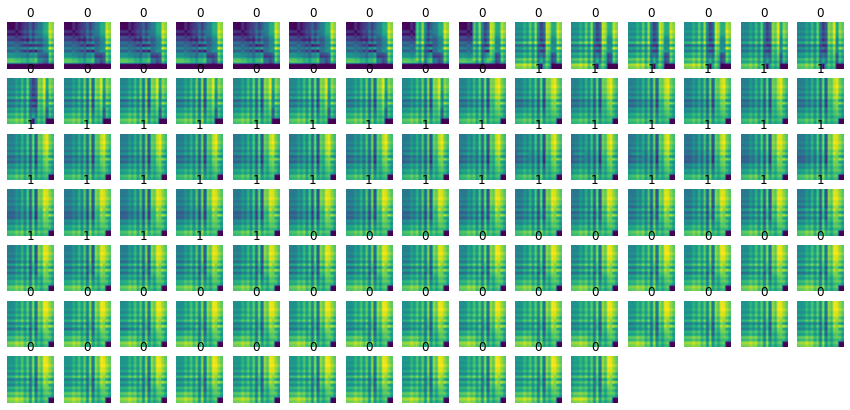

08_01_3_6


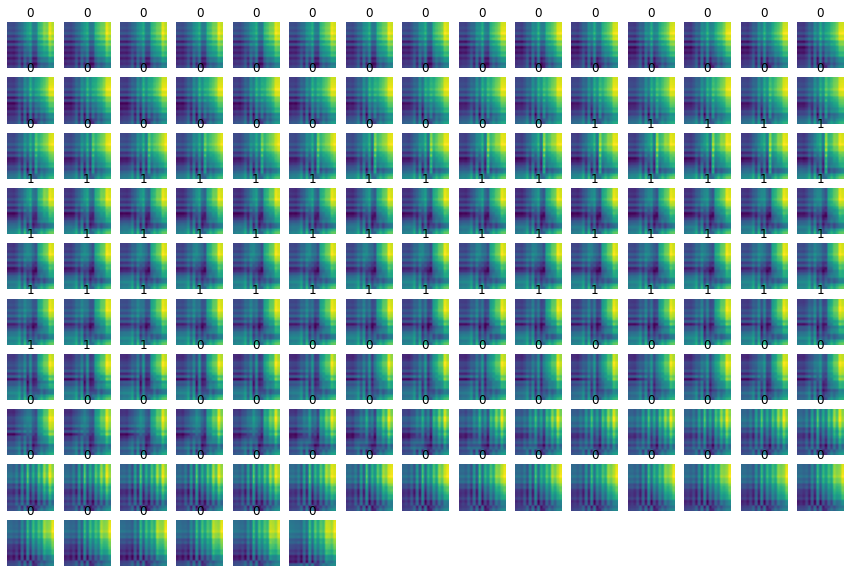

08_02_1_2


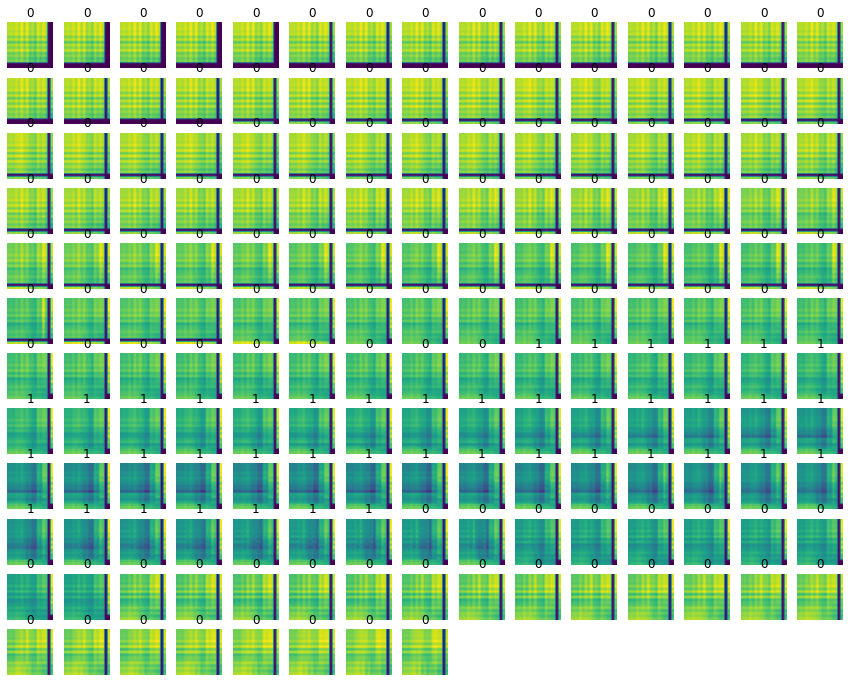

08_03_4_5


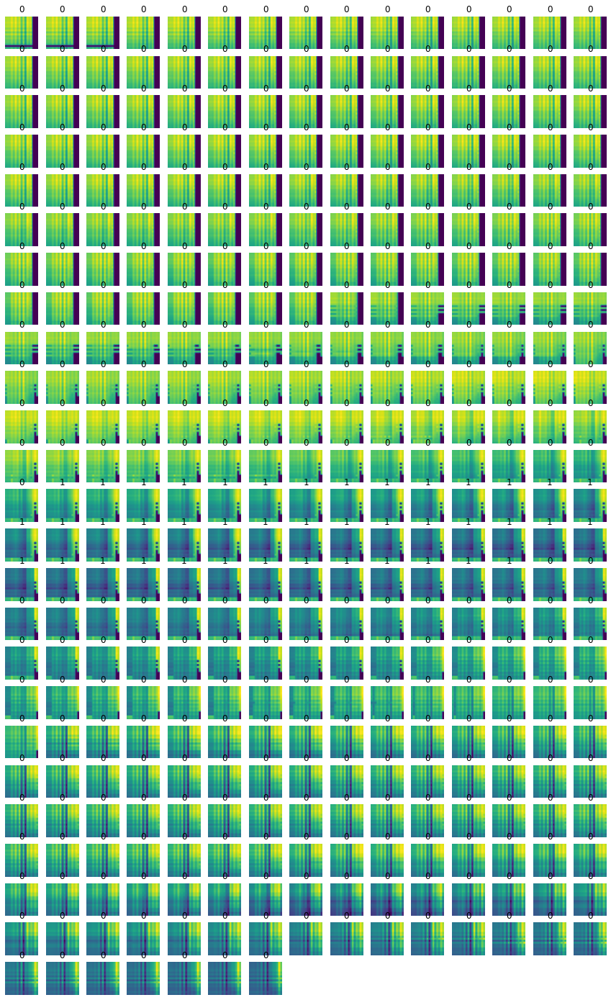

08_04_2_3


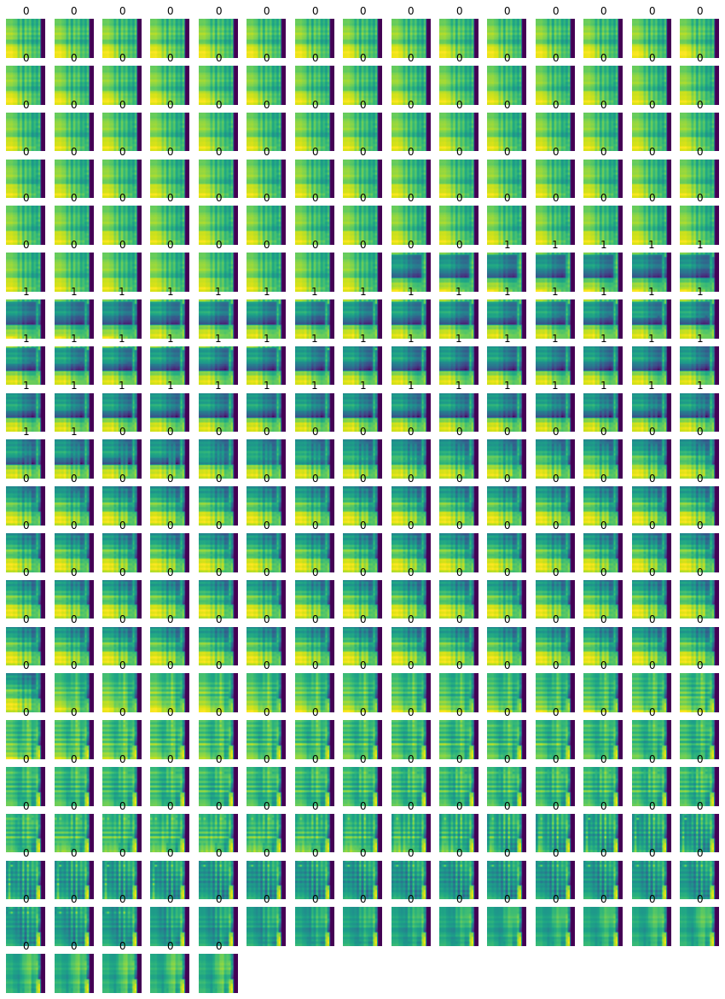

08_05_1_2


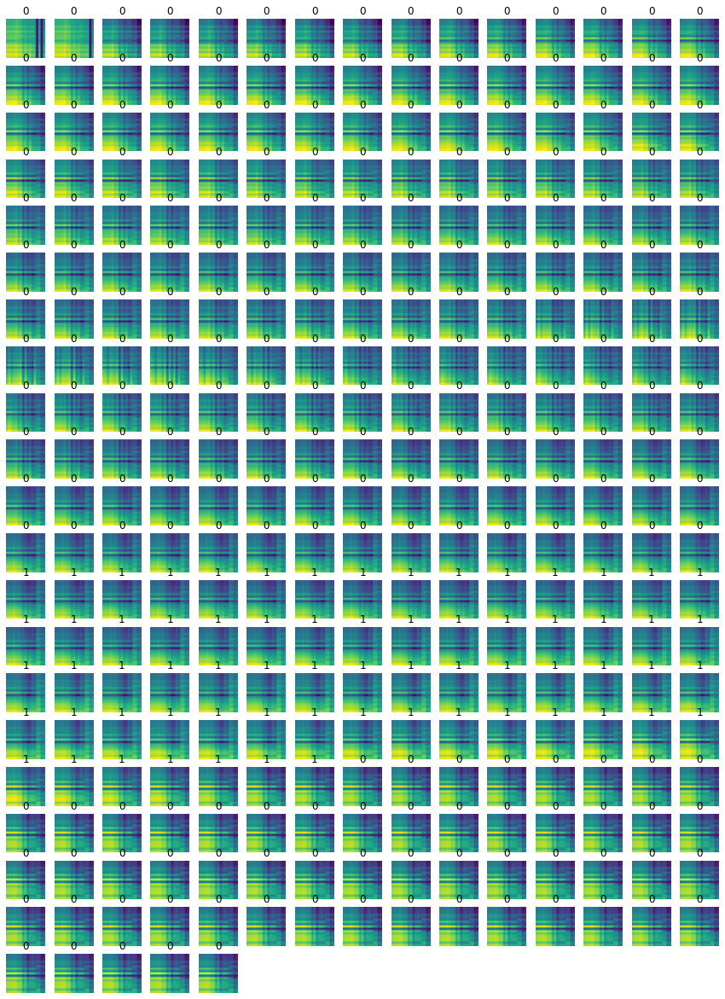

08_06_0_5


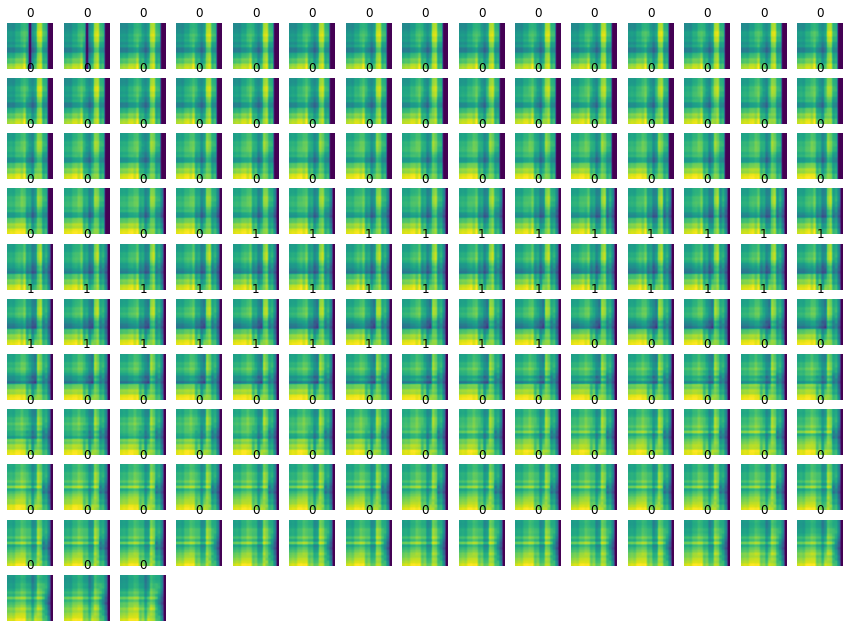

08_07_3_6


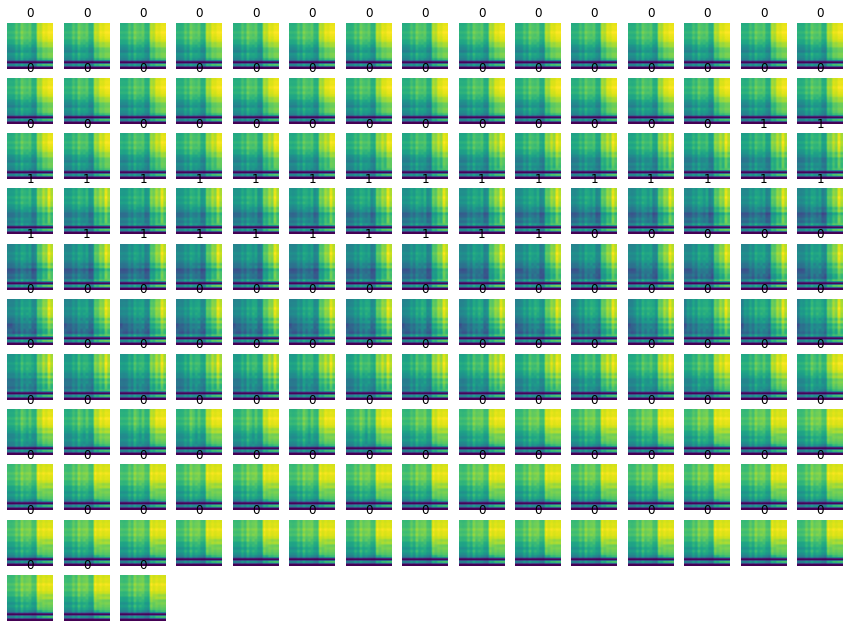

08_08_0_2


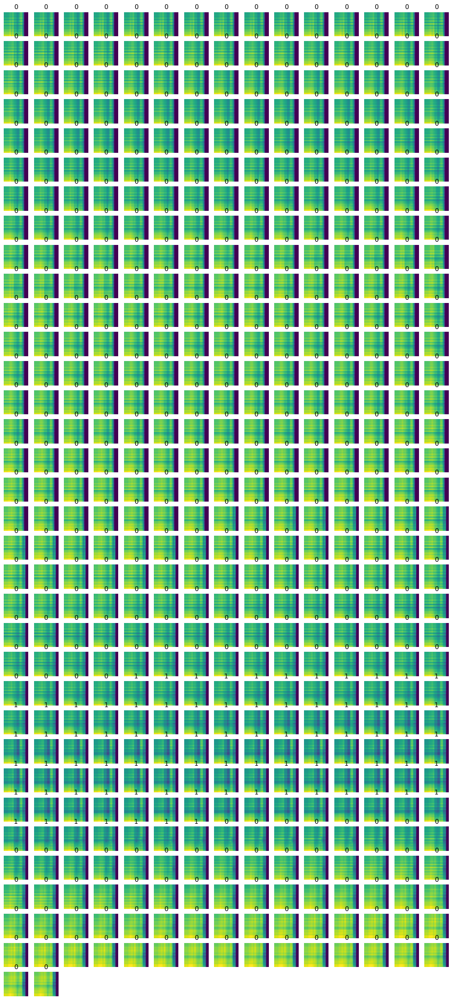

08_09_0_2


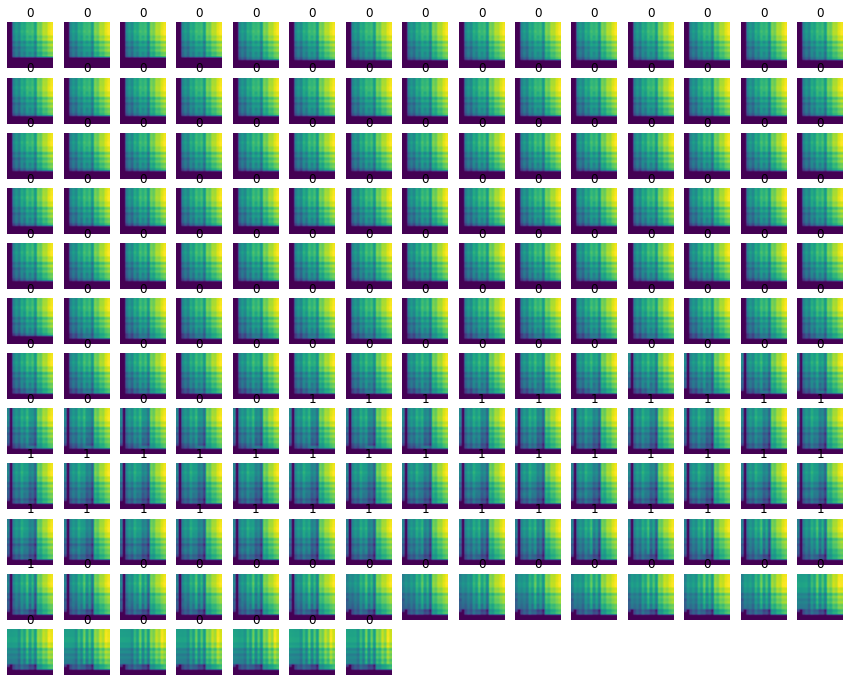

08_10_1_3


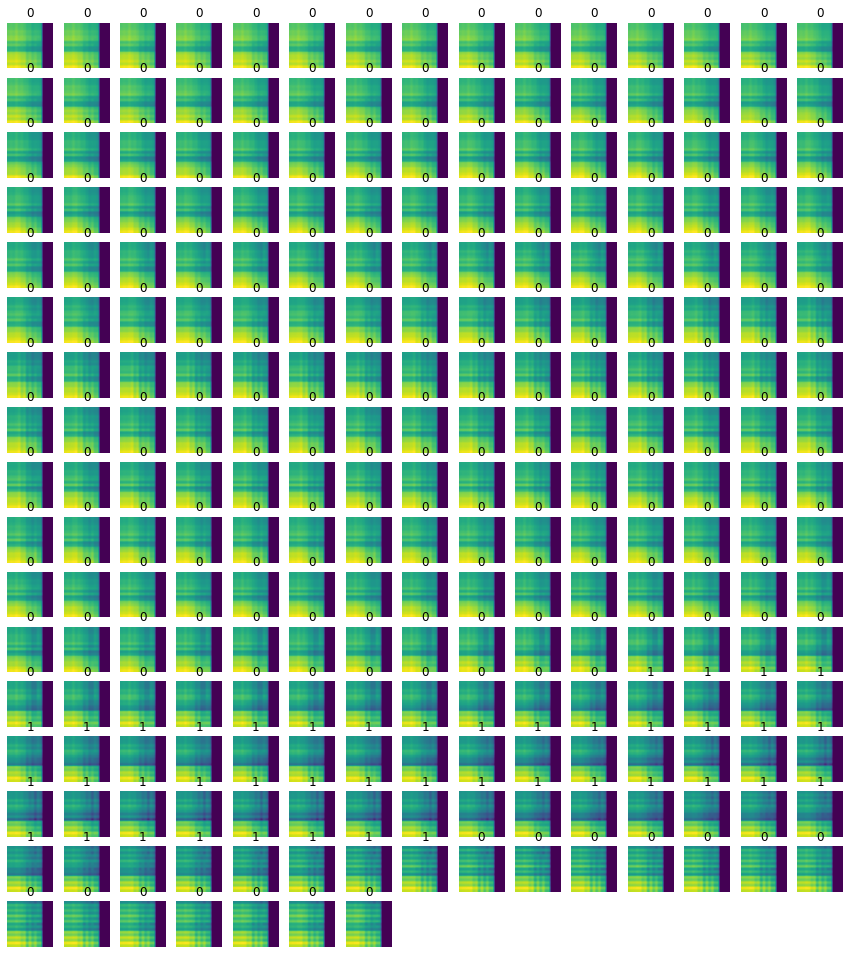

08_11_0_2


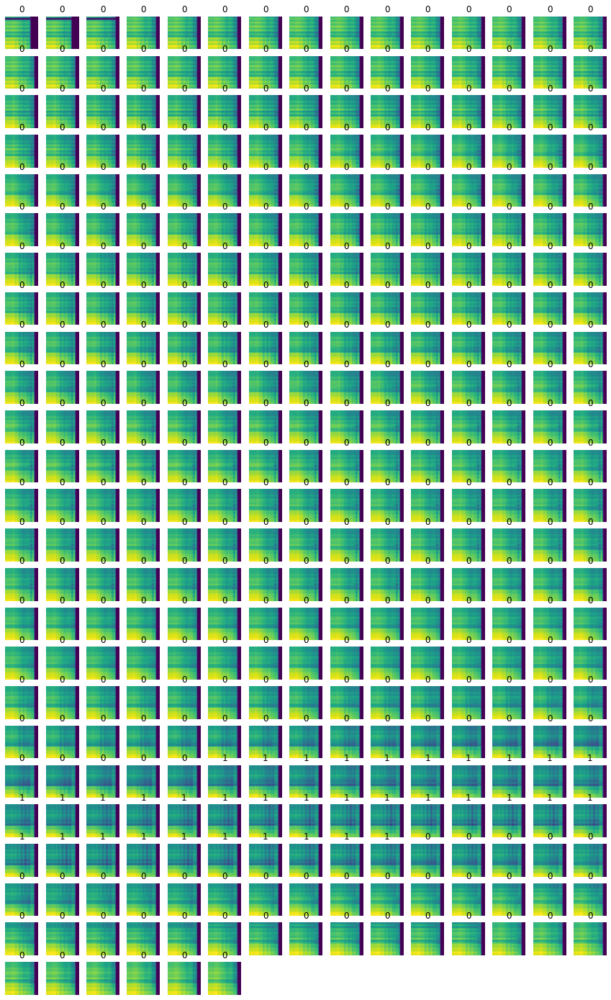

08_12_2_3


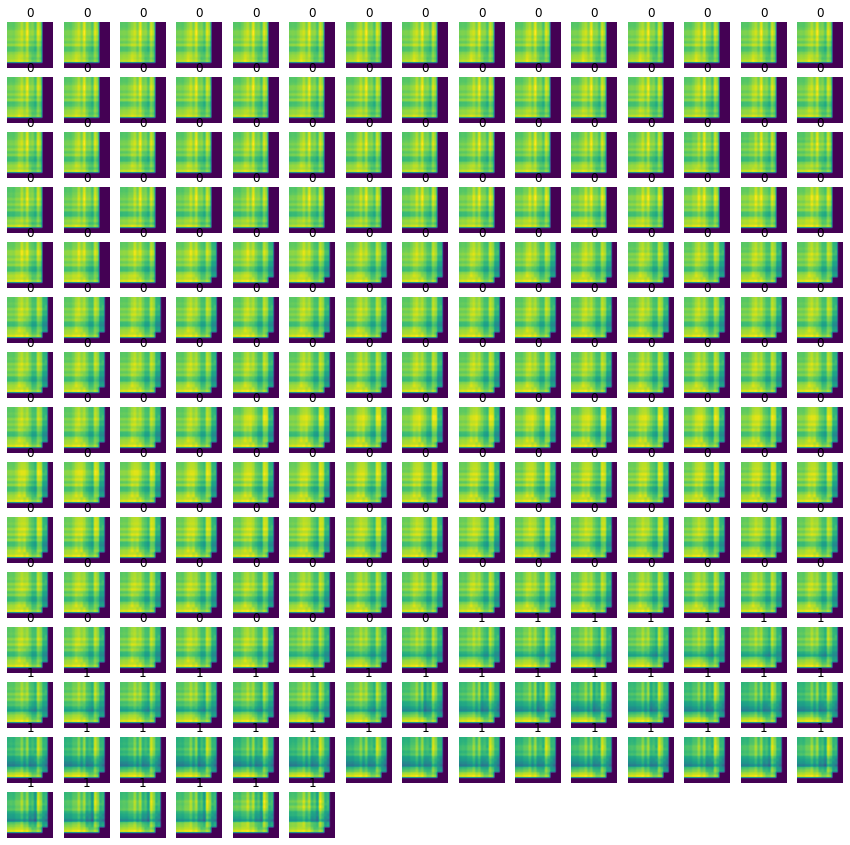

08_13_0_4


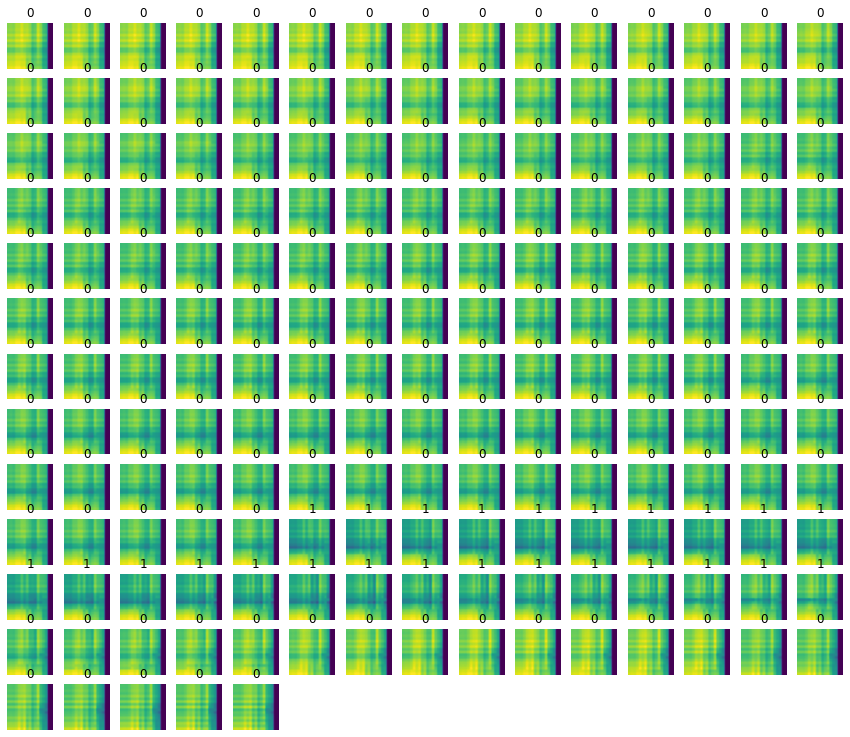

08_14_2_3


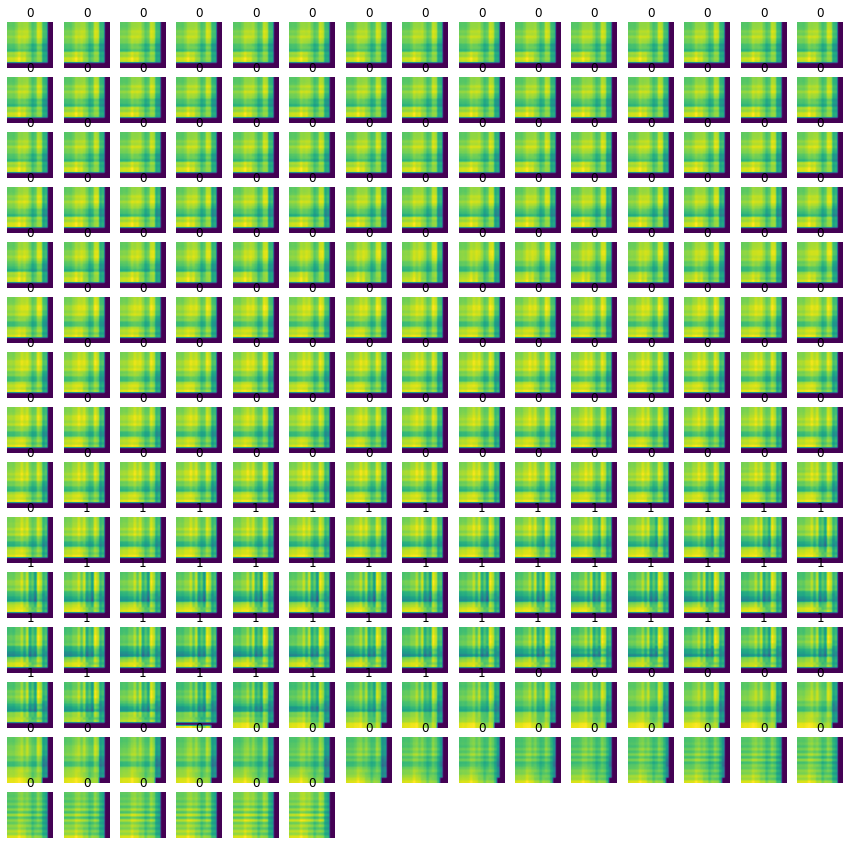

08_15_1_3


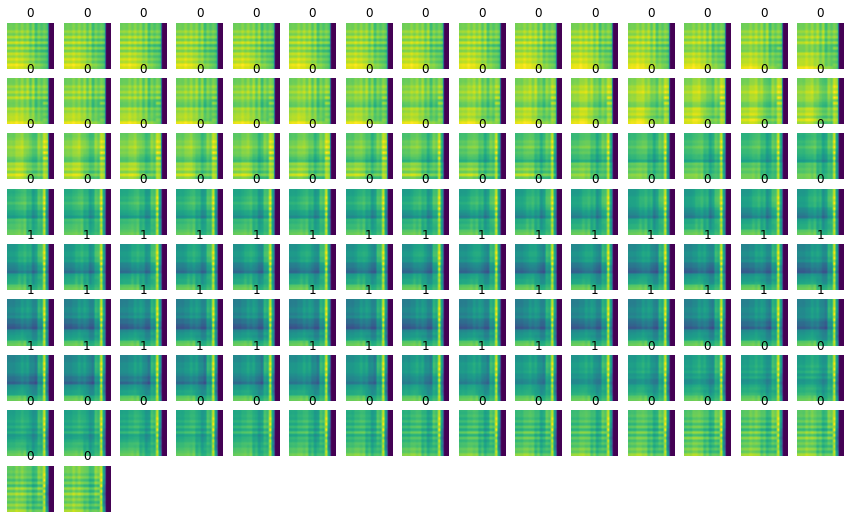

08_16_0_1


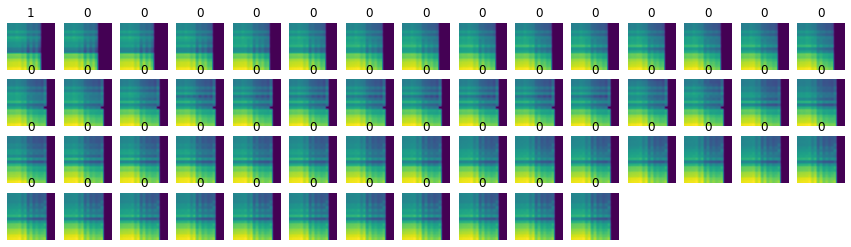

08_17_0_3


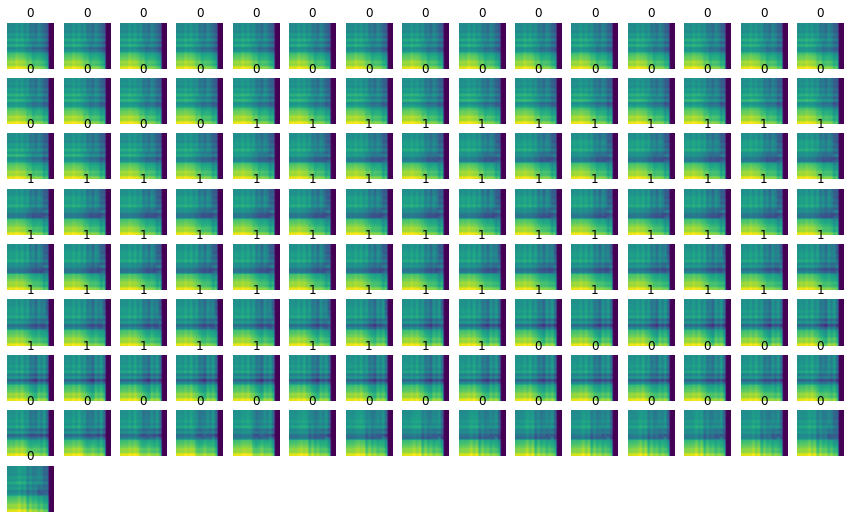

08_18_0_3


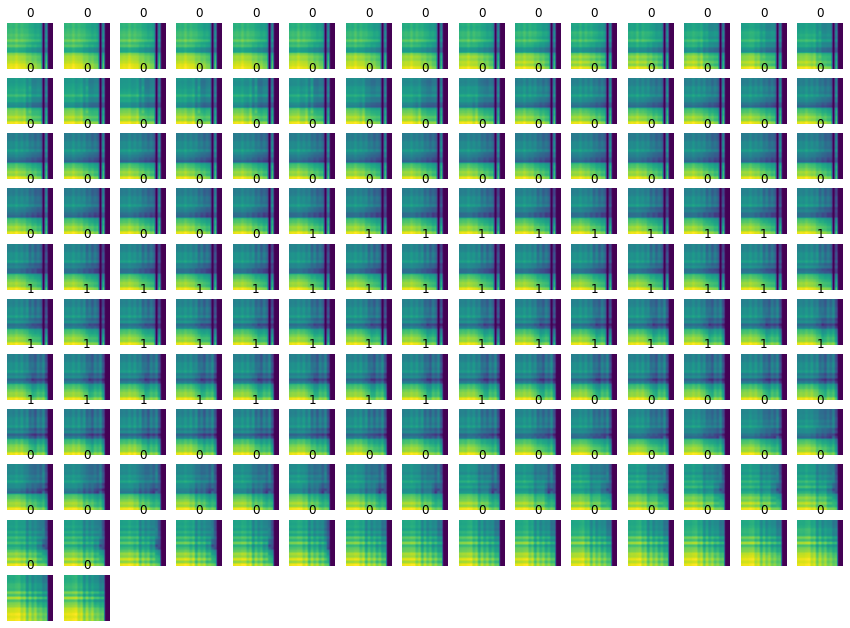

08_19_1_2


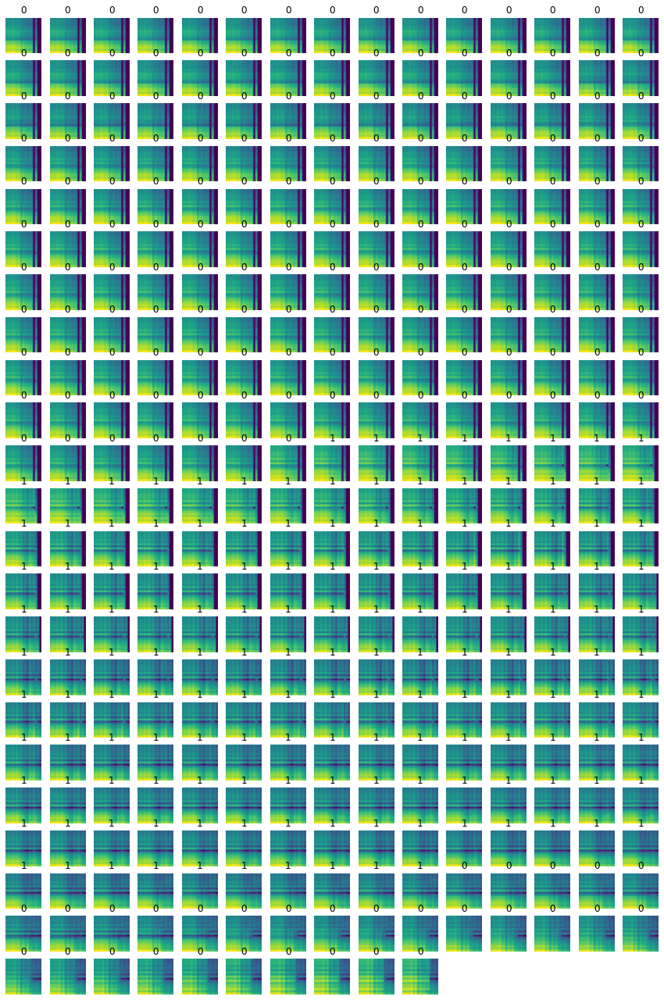

08_20_0_3


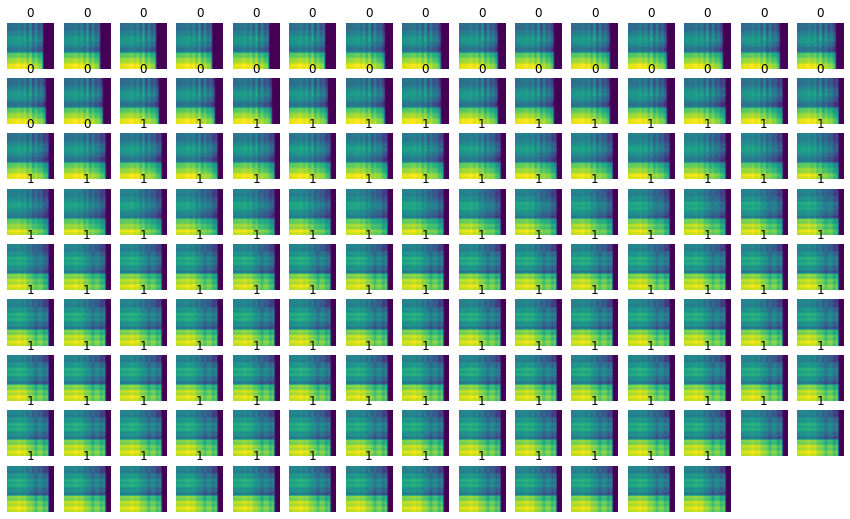

08_21_0_4


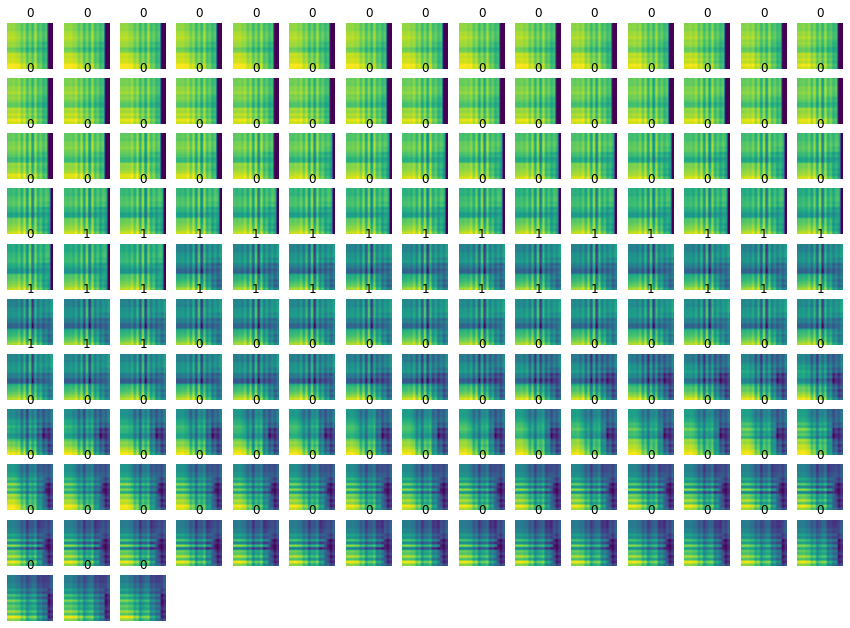

08_22_0_4


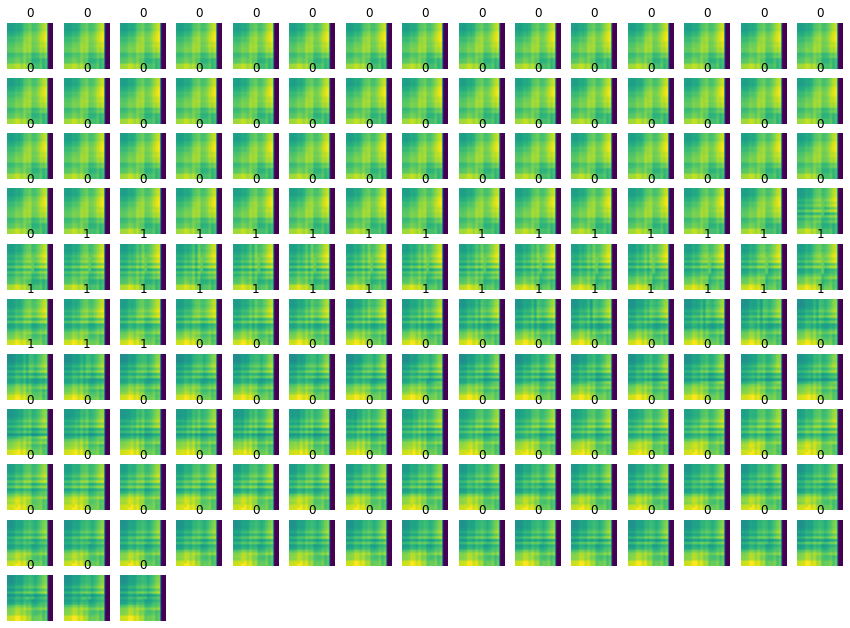

08_23_0_1


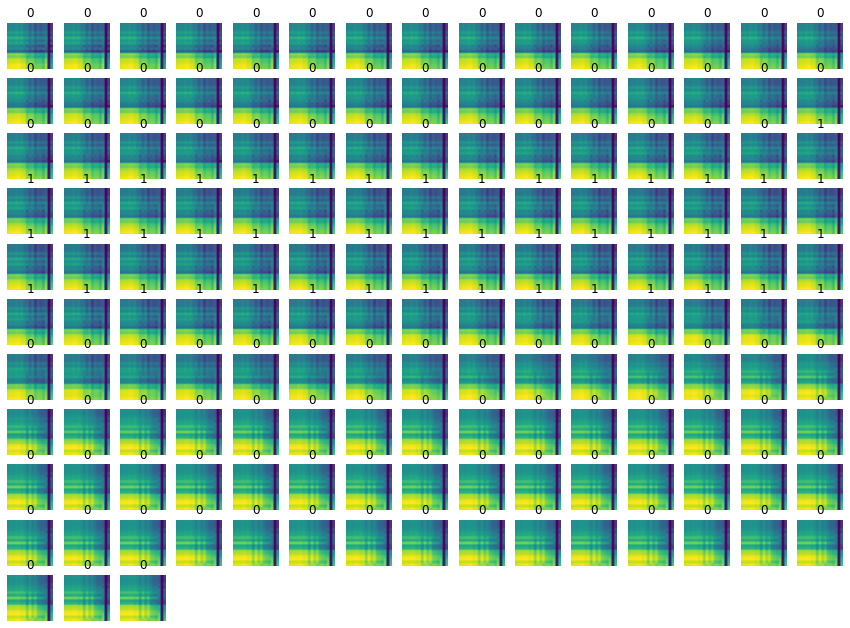

08_24_1_6


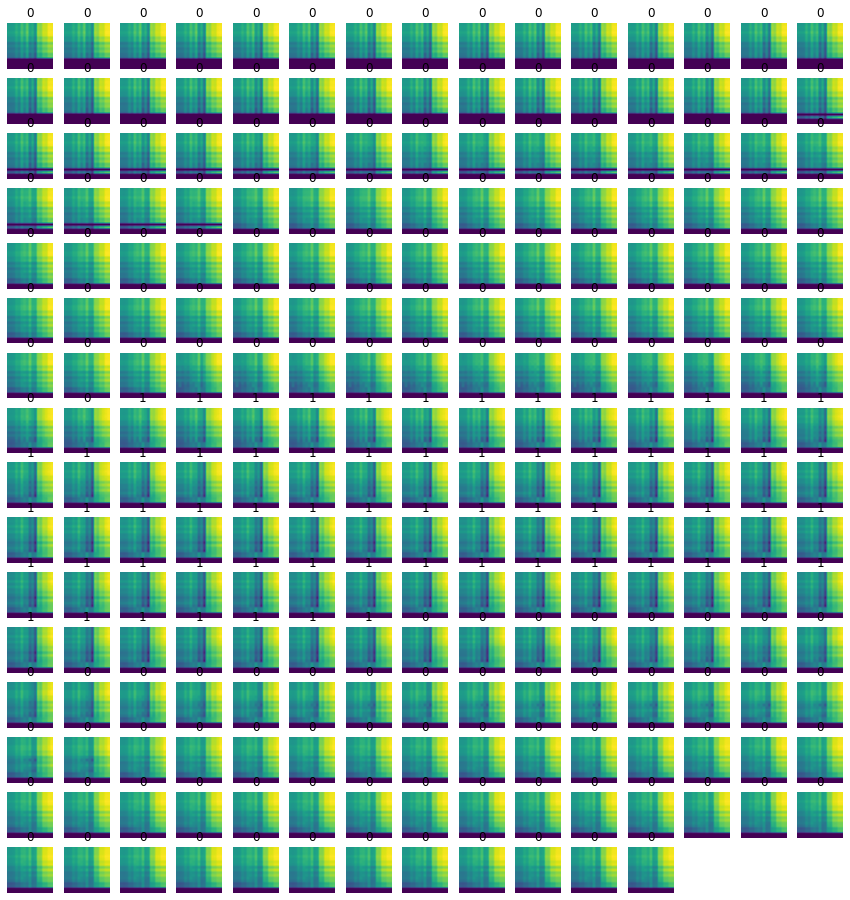

08_25_2_9


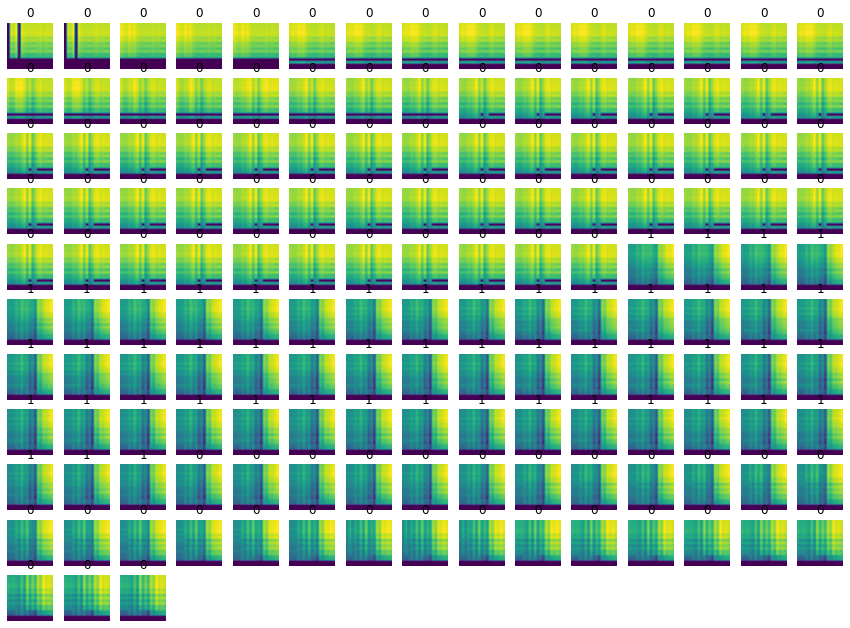

08_26_2_10


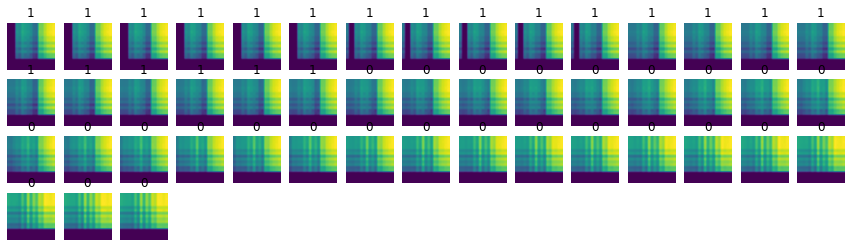

08_27_4_11


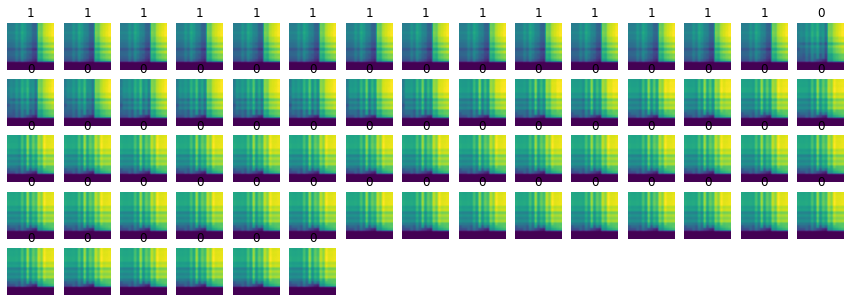

08_28_4_11


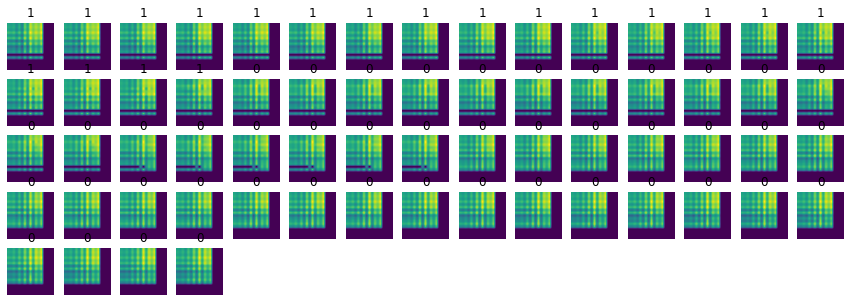

08_29_2_5


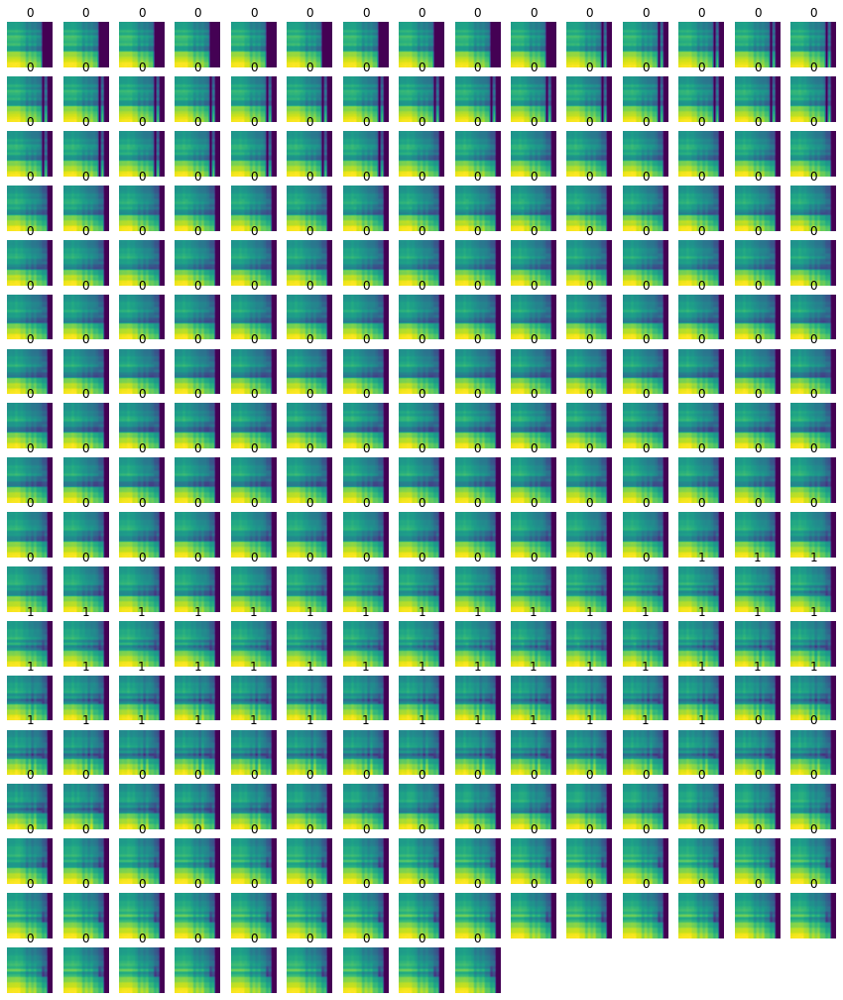

08_30_0_1


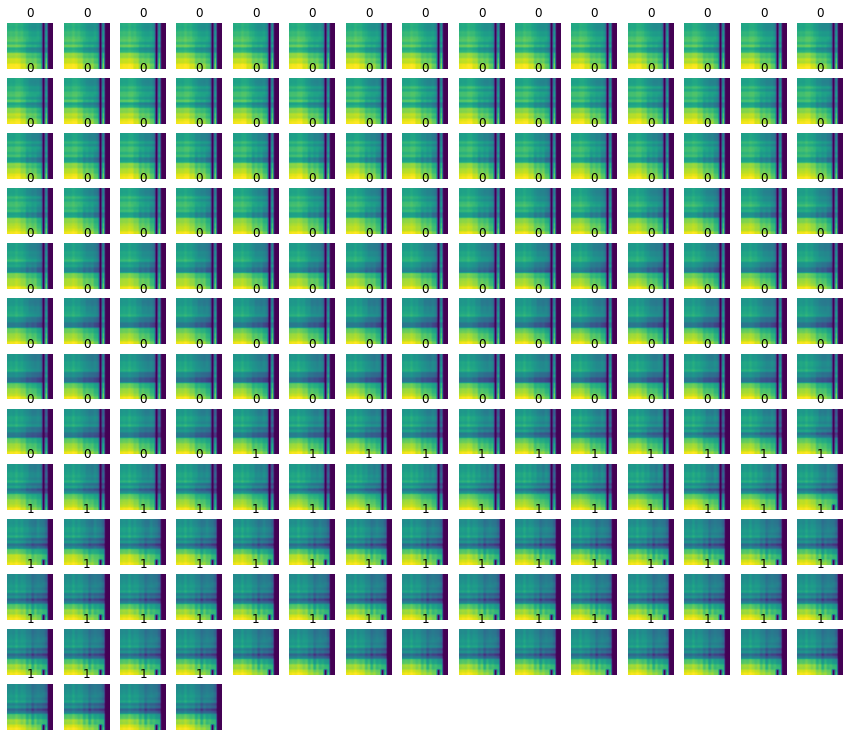

08_31_2_4


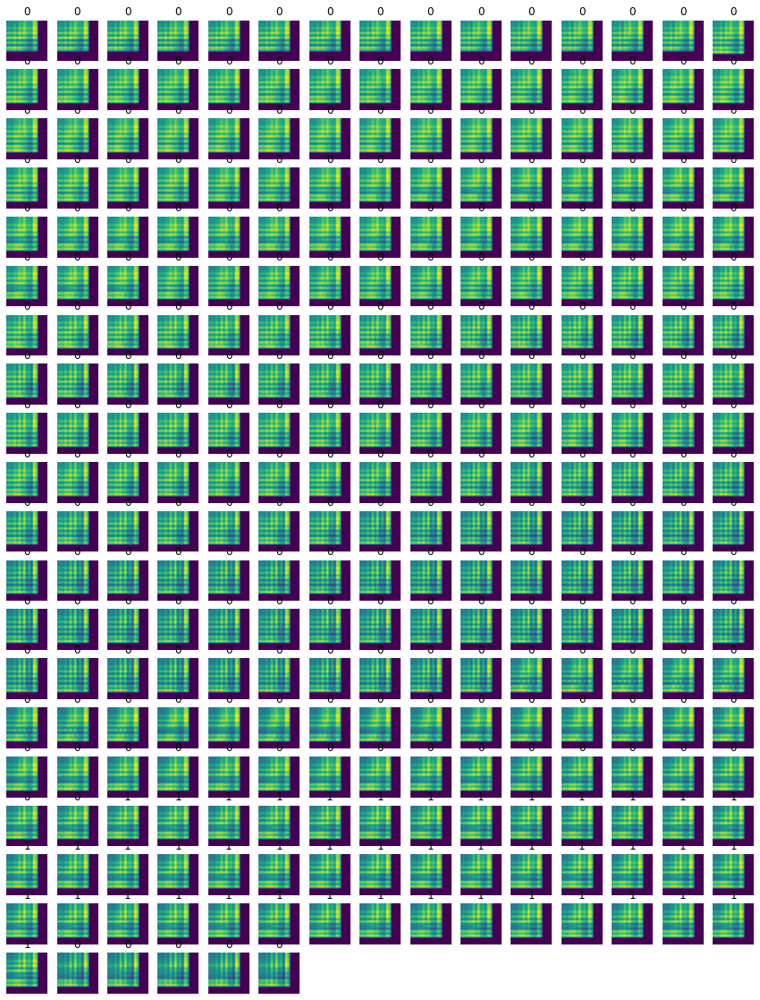

08_32_0_1


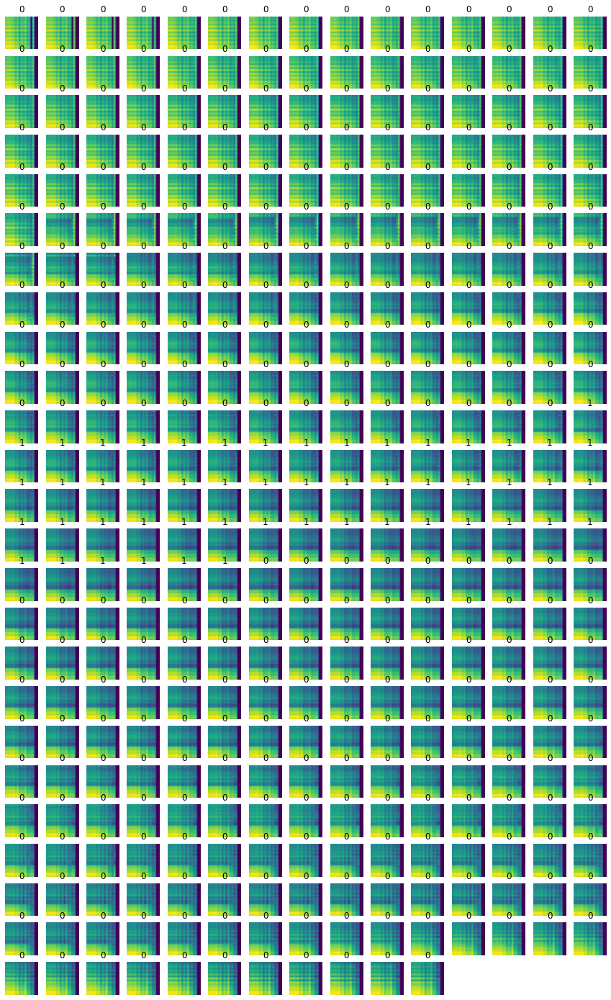

08_33_0_7


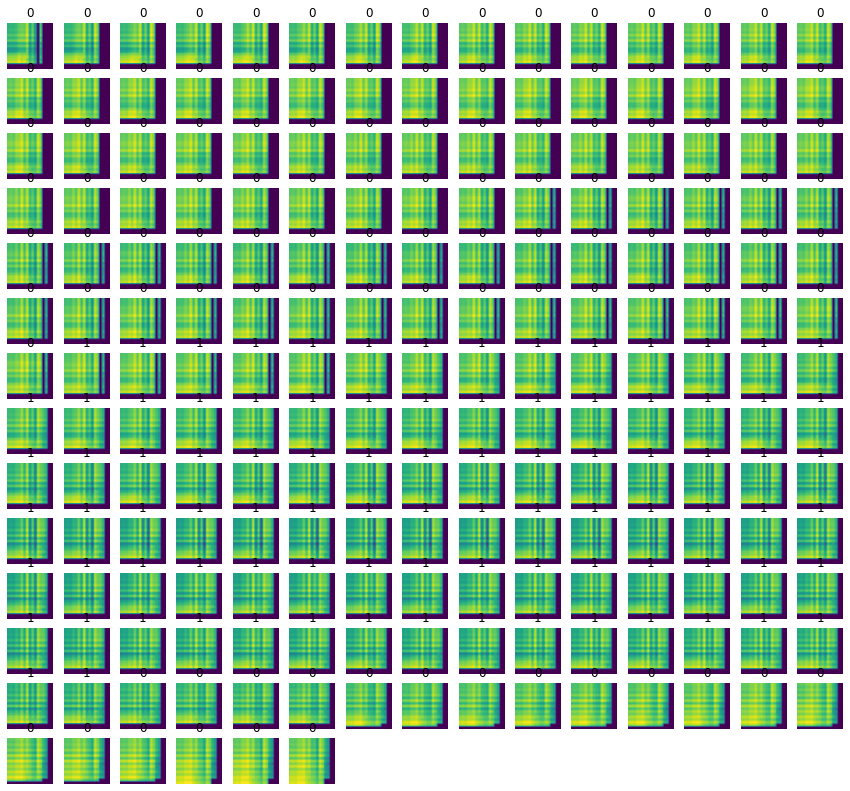

08_34_0_2


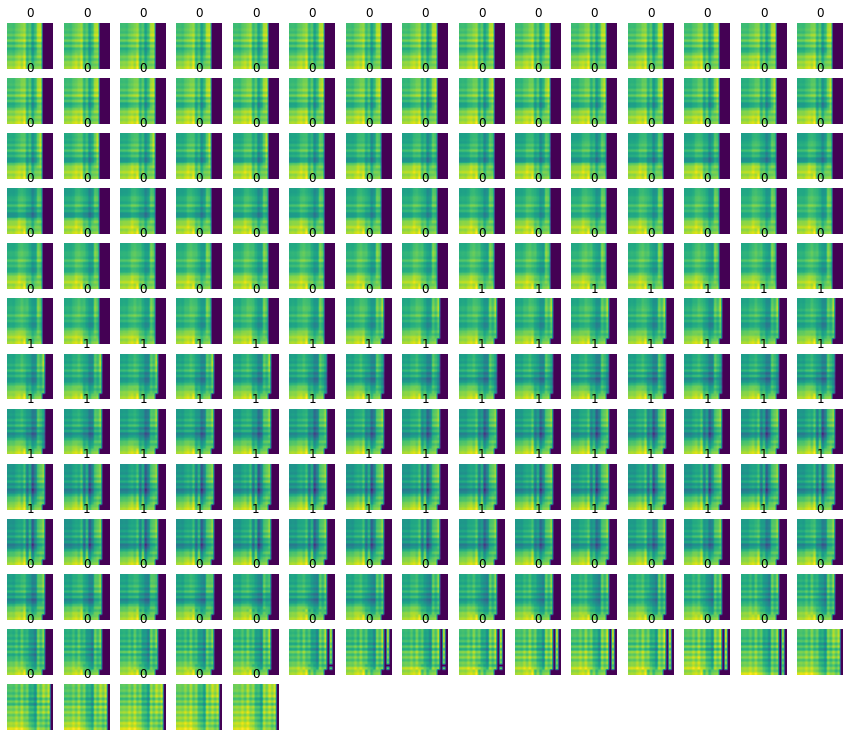

08_35_0_2


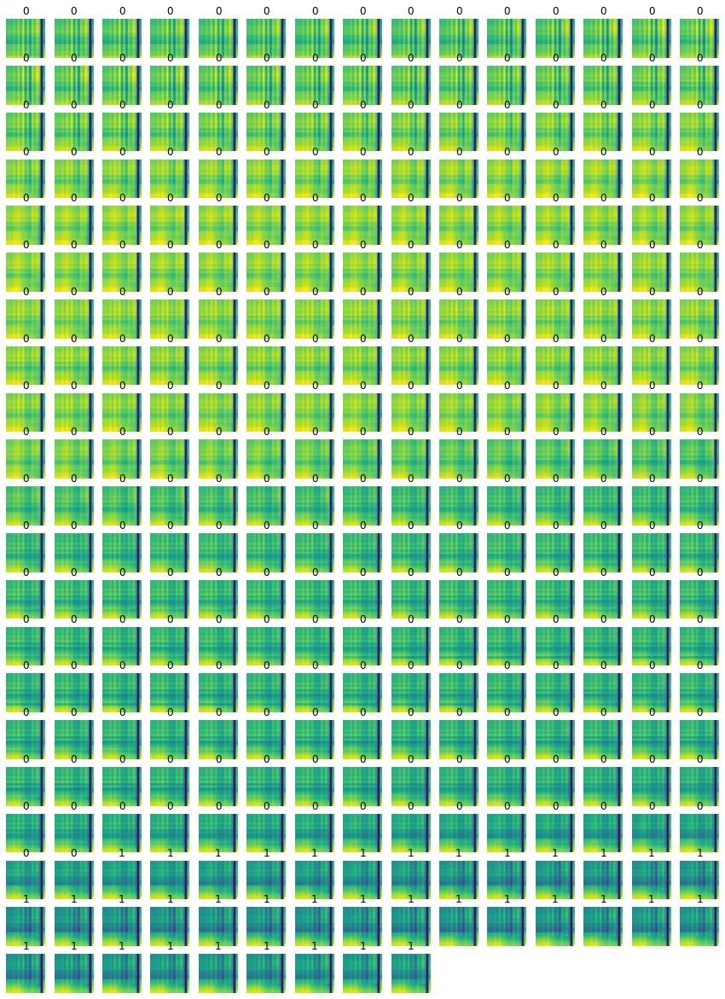

08_36_0_2


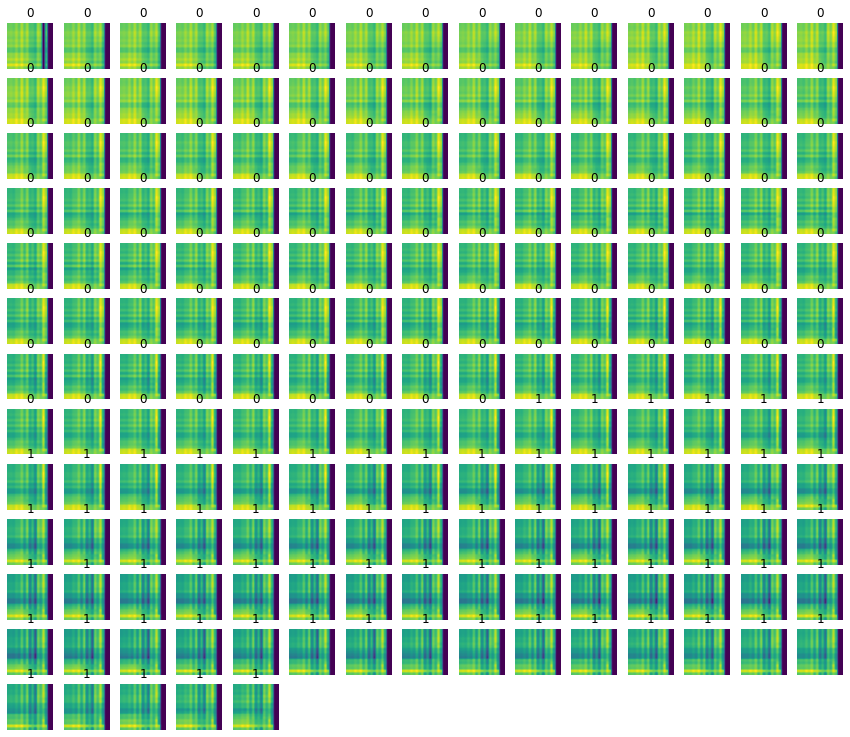

08_37_2_3


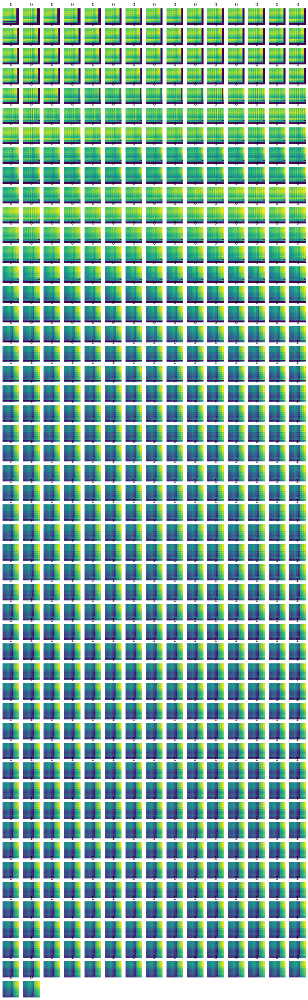

08_38_0_2


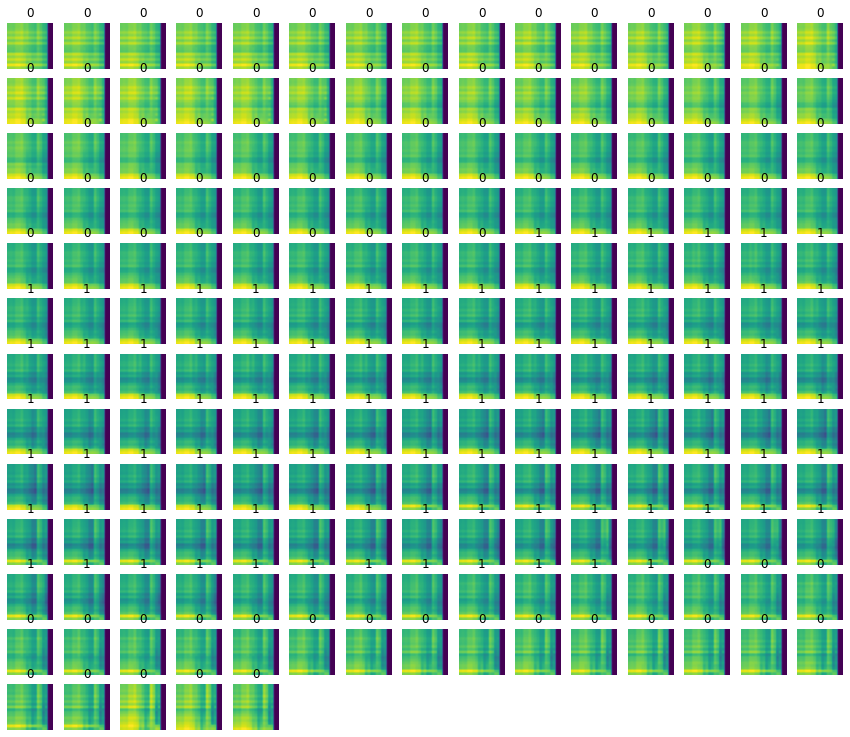

08_39_0_2


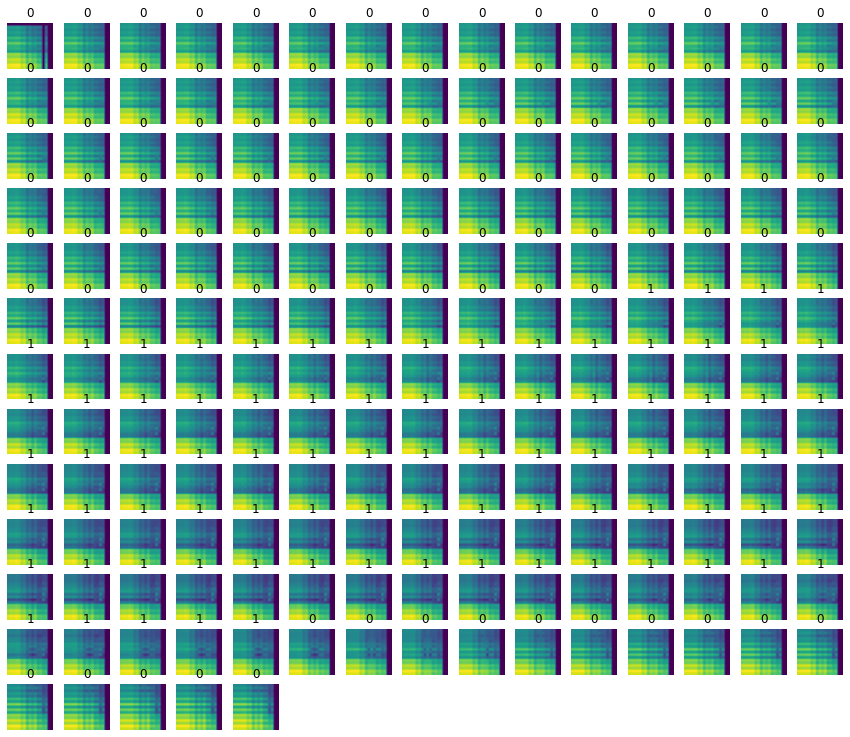

08_40_0_1


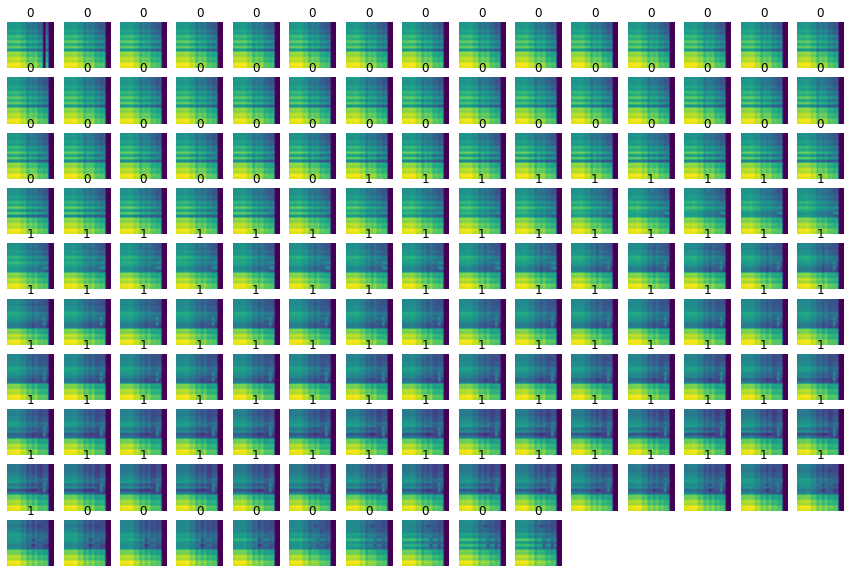

08_41_1_3


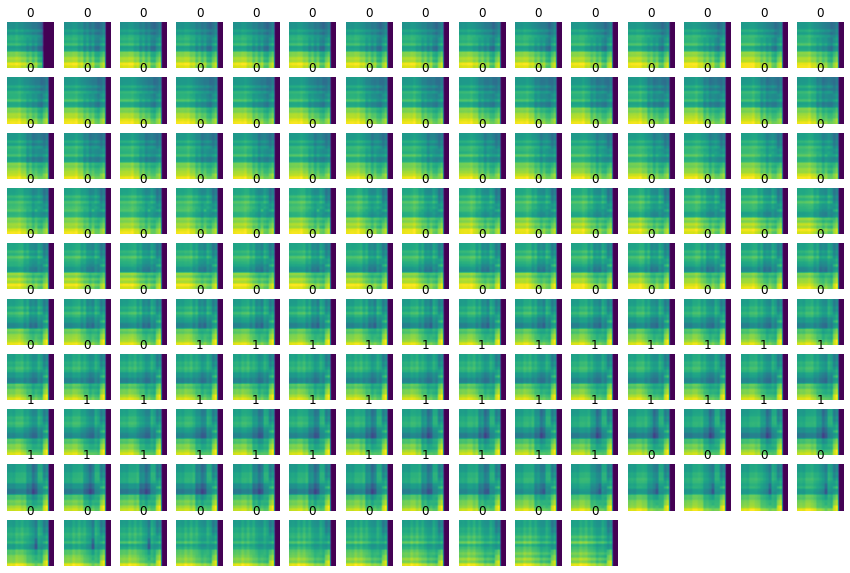

09_01_0_5


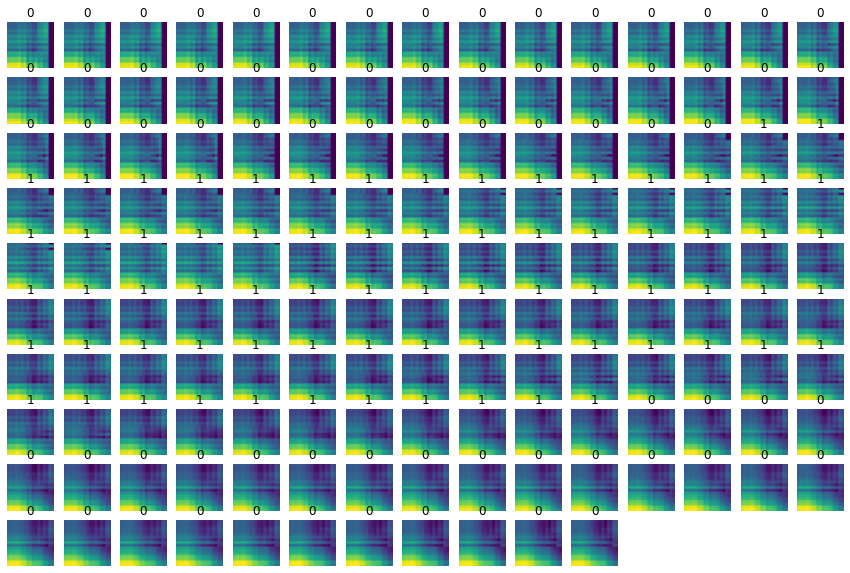

09_02_5_7


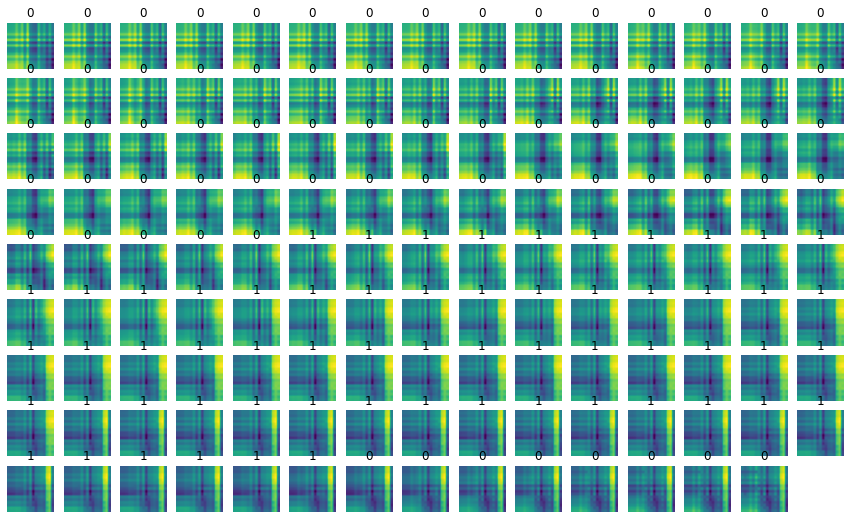

09_03_0_3


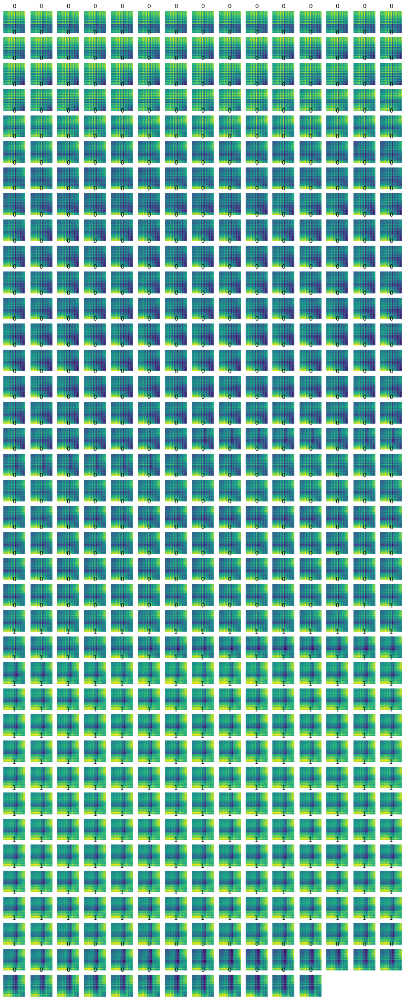

09_04_1_3


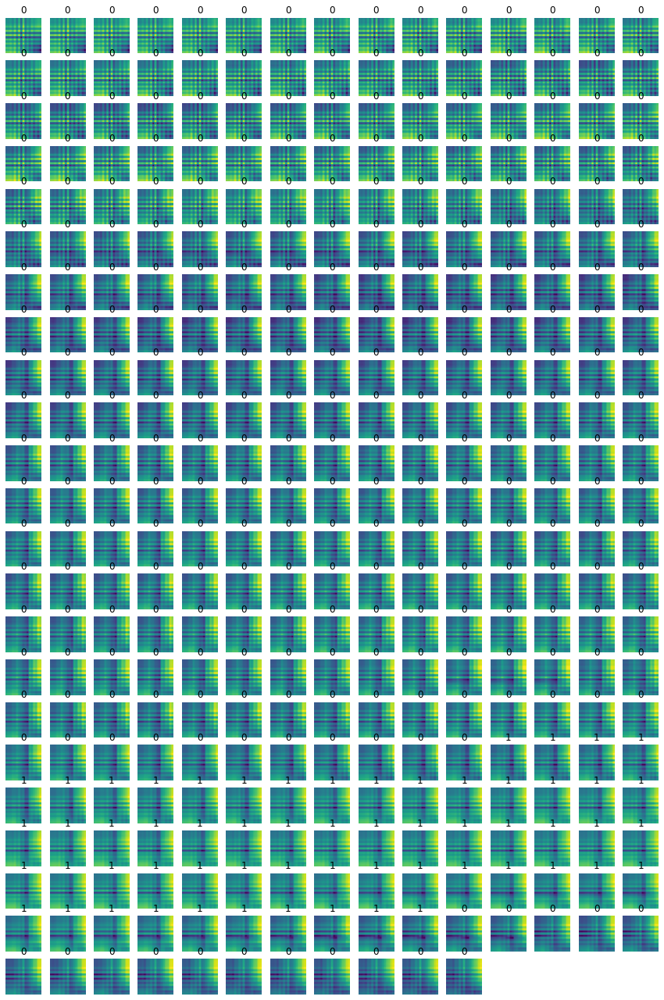

09_05_3_13


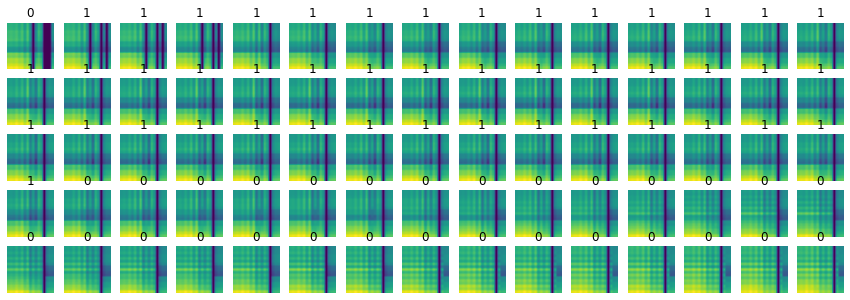

09_06_0_2


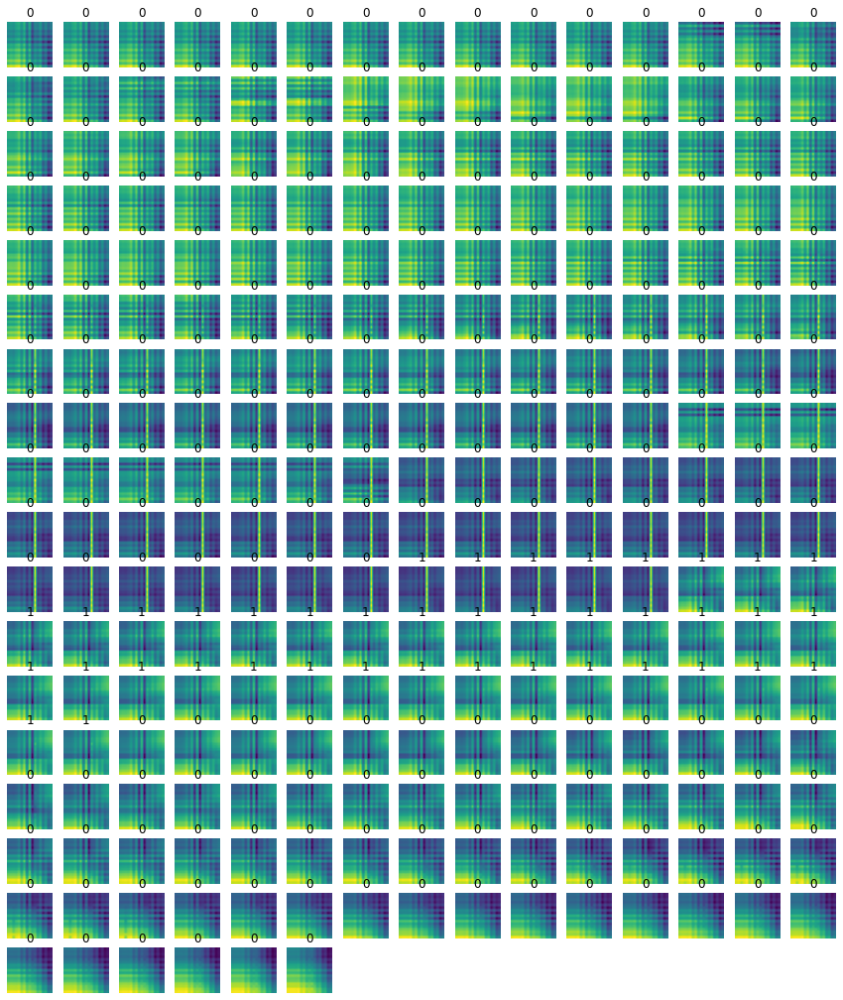

09_07_1_3


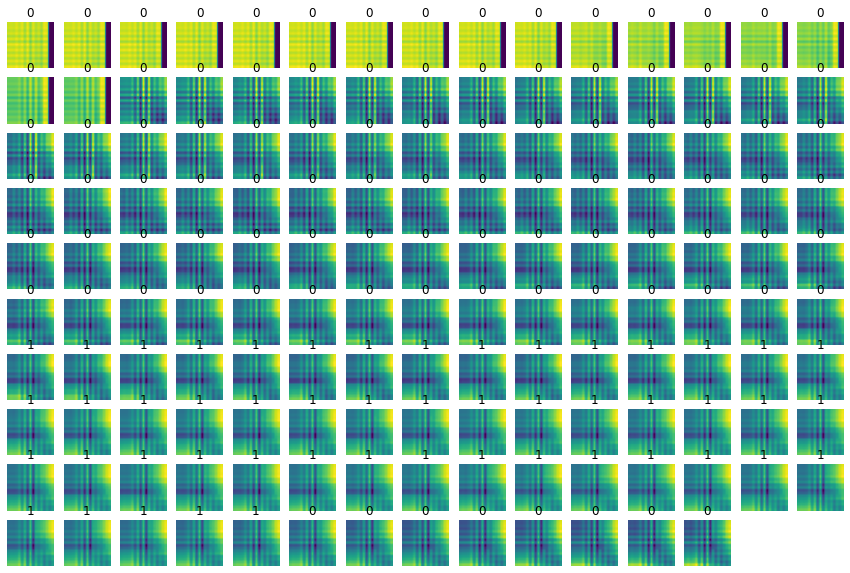

09_08_0_3


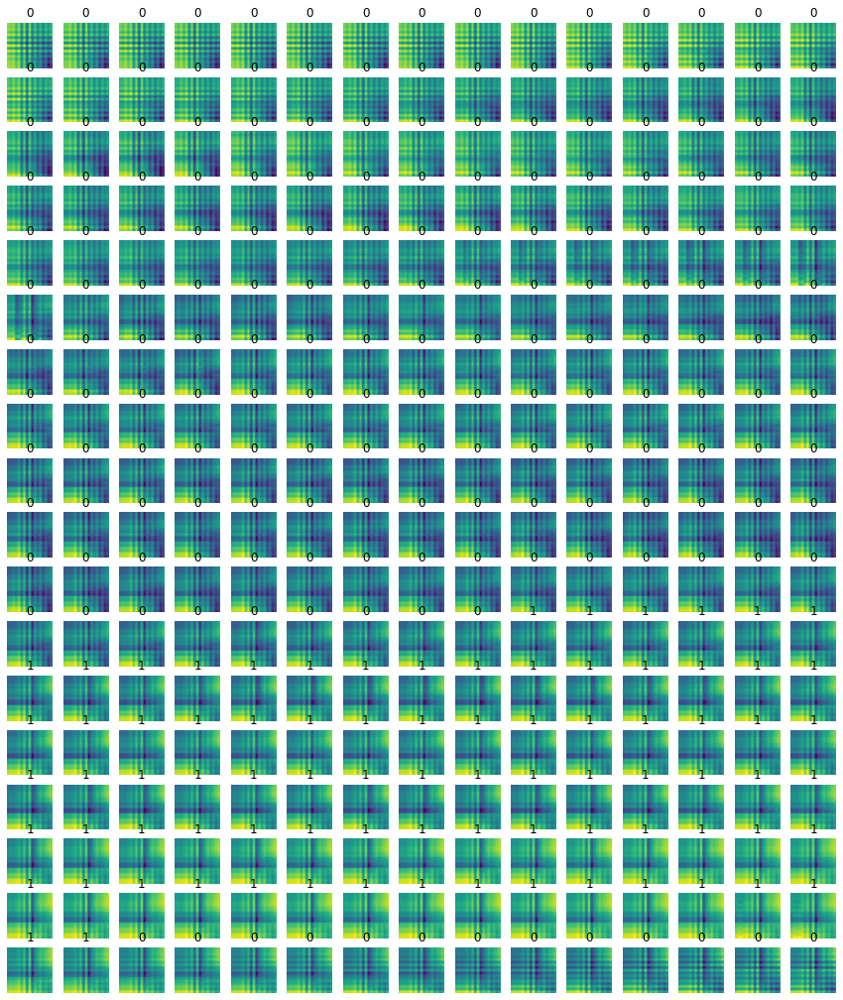

09_09_1_2


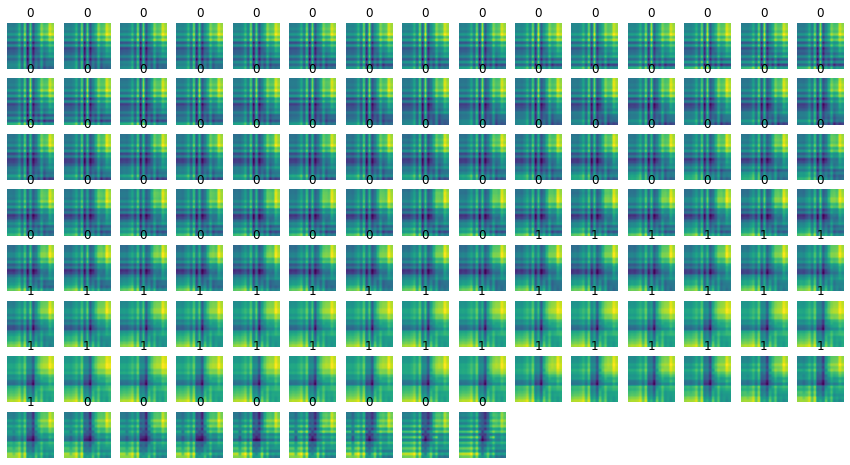

In [11]:
for key, x_lst, y_lst in zip(x_dict_std.keys(), x_dict_std.values(), y_dict_std.values()):
    if 1 not in y_lst:
        continue

    col_num = 15
    row_num = len(x_lst) // col_num + 1
    
    print(key)
    fig = plt.figure(figsize=(col_num, row_num))
    for i, x in enumerate(x_lst):
        ax = fig.add_subplot(row_num, col_num, i + 1)
        ax.imshow(x)
        ax.set_title(y_lst[i])
        ax.axis('off')
    plt.show()

In [12]:
len_pass = len([key for key, y_lst in y_dict_std.items() if 1 in y_lst])
len_not_pass = len([key for key, y_lst in y_dict_std.items() if 0 in y_lst])

print(f'all length:{len(y_lst)}')
print(f'passing: {len_pass}')
print(f'not passing: {len_not_pass}')

all length:87
passing: 69
not passing: 4092


In [13]:
y_lst_all = []
for y_lst in y_dict_std.values():
    y_lst_all += y_lst

len_pass = len([i for i in y_lst_all if i == 1])
len_not_pass = len([i for i in y_lst_all if i == 0])

print(f'all length:{len(y_lst_all)}')
print(f'passing: {len_pass}')
print(f'not passing: {len_not_pass}')

all length:368210
passing: 4079
not passing: 364131


# 深層学習

In [11]:
SIZE = 17
MAGNIFICATION = 2

# model settings
SEQ_LEN = 16

# leraning rate
LR = 0.001

# training and data settings
EPOCH = 30
BATCH_SIZE = 512  # note: size of cuda memory
TRAIN_RATIO = 0.7
VAL_RATIO = 0.05

config = {
    'seq_len': SEQ_LEN,
    'raw_size': SIZE,
    'magnification': MAGNIFICATION,
    'size': SIZE * MAGNIFICATION,
    'n_channel': 1,
    'n_convs': 2,
    'conv_hidden_dims': [128, 256],
    'conv_is_doubles': [False, True],
    'kernel_sizes':[(3, 3, 3), (3, 3, 3)],  # (depth, height, width)
    'n_linears': 2,
    'hidden_dims': [256, 128],
    'dropouts': [0.1, 0],
    'n_classes': 2,
    'lr': LR,
    'epoch': EPOCH,
    'batch_size':BATCH_SIZE,
    'device': device,
}

# setting random seed
SEED = 64
np.random.seed(SEED)
torch.manual_seed(SEED)

## データセット生成

In [12]:
def create_sequence(x_lst, y_lst, **config):
    seq_len = config['seq_len']
    size = config['raw_size']
    mag = config['magnification']
    n_channel = config['n_channel']
    x_seq = []
    y_seq = []
    for i in range(len(x_lst) - seq_len + 1):
        x = np.array(x_lst[i:i + seq_len])
        x = x.reshape(n_channel, seq_len, size, size)
        x = x.repeat(mag, axis=2).repeat(mag, axis=3)
        x_seq.append(x)
        y_seq.append(y_lst[i + seq_len - 1])
    
    return x_seq, y_seq


class MyDataset(Dataset):
    def __init__(self, x_dict, y_dict, **kwargs):
        self.x, self.y = [], []
        for key in tqdm(x_dict.keys()):
            x_lst = x_dict[key]
            y_lst = y_dict[key]
            x_seq, y_seq = create_sequence(x_lst, y_lst, **config)
            self.x += x_seq
            self.y += y_seq
            
        self.device = kwargs['device']
            
    def __getitem__(self, index):
        return (
            tensor(self.x[index]).float().to(self.device),
            tensor(np.identity(2)[self.y[index]]).float().to(self.device)
        )

    def __len__(self):
        return len(self.x)

In [13]:
train_len = int(len(x_dict_std) * TRAIN_RATIO)
val_len = int(len(x_dict_std) * VAL_RATIO)

random_keys = np.random.choice(
    list(x_dict_std.keys()),
    size=len(x_dict_std),
    replace=False
)

train_keys = random_keys[:train_len]
val_keys = random_keys[train_len:train_len + val_len]
test_keys = random_keys[train_len + val_len:]

x_train_dict = {key: x_dict_std[key] for key in train_keys}
y_train_dict = {key: y_dict_std[key] for key in train_keys}
train_dataset = MyDataset(x_train_dict, y_train_dict, **config)
print(len(train_dataset))
train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True
)

x_val_dict = {key: x_dict_std[key] for key in val_keys}
y_val_dict = {key: y_dict_std[key] for key in val_keys}
val_loader = DataLoader(
    MyDataset(x_val_dict, y_val_dict, **config),
    batch_size=BATCH_SIZE,
    shuffle=False
)

x_test_dict = {key: x_dict_std[key] for key in test_keys}
y_test_dict = {key: y_dict_std[key] for key in test_keys}
test_loader = DataLoader(
    MyDataset(x_test_dict, y_test_dict, **config),
    batch_size=BATCH_SIZE,
    shuffle=False
)

100%|██████████| 2865/2865 [00:25<00:00, 114.07it/s]


222189


100%|██████████| 1024/1024 [00:09<00:00, 113.44it/s]


## モデル作成

In [14]:
class CNNModel(nn.Module):
    def __init__(self, **config):
        super(CNNModel, self).__init__()

        # init conv 3d layers
        self.convs = nn.Sequential()
        conv_out_shape = np.array((config['seq_len'], config['size'], config['size']))
        for i in range(config['n_convs']):
            if i == 0:
                in_c = config['n_channel']
            else:
                in_c = config['conv_hidden_dims'][i - 1]
            out_c = config['conv_hidden_dims'][i]
            is_double = config['conv_is_doubles'][i]
            kernel_size = config['kernel_sizes'][i]
            stride = (1, 1, 1)
            padding = (0, 1, 1)
            
            self.convs.add_module(
                f'conv{i + 1}',
                Conv3d(
                    in_c, out_c,
                    kernel_size,
                    stride,
                    padding,
                    is_conv_double=is_double)
            )
            
            # calclate conv output
            conv_out_shape = self._calc_conv_out(conv_out_shape, kernel_size, padding, stride)  
            if is_double:
                conv_out_shape = self._calc_conv_out(conv_out_shape, kernel_size, padding, stride) 
            # calclate maxpool output
            conv_out_shape = self._calc_conv_out(conv_out_shape, (2, 2, 2), (0, 0, 0), (2, 2, 2))
        
        # init linear layers
        self.linears = nn.Sequential()
        for i in range(config['n_linears']):
            if i == 0:
                in_dim = 1
                for dim in conv_out_shape:
                    in_dim *= dim 
                in_dim *= config['conv_hidden_dims'][-1]
            else:
                in_dim = config['hidden_dims'][i - 1]
            out_dim = config['hidden_dims'][i]
            dropout = config['dropouts'][i]
            self.linears.add_module(
                f'fc{i + 1}',
                Linear(in_dim, out_dim, dropout)
            )

        # init output layers
        self.output_layer = nn.Linear(config['hidden_dims'][-1], config['n_classes'])
        self.softmax = nn.Softmax(dim=1)
        
    def _calc_conv_out(slef, o, k, p, s):
        # [(W−K+2P)/S]+1
        return ((o - k + 2 * np.array(p)) / s).astype(int) + 1

    def forward(self, x):
        x = self.convs(x)
        x = x.view(x.size(0), -1)
        x = self.linears(x)
        x = self.output_layer(x)
        x = self.softmax(x)
        
        return x
    
class Conv3d(nn.Sequential):
    def __init__(
        self, in_c, out_c,
        kernel_size=(3, 3, 3),  # depth, height, width
        stride=(1, 1, 1),  # depth, height, width
        padding=(0, 1, 1),  # depth, height, width
        is_conv_double=False,
    ):
        modules = []
        modules.append(nn.Conv3d(
            in_c, out_c,
            kernel_size=kernel_size,
            stride=stride,
            padding=padding
        ))
        modules.append(nn.LeakyReLU())
        if is_conv_double:
            modules.append(nn.Conv3d(
                out_c, out_c,
                kernel_size=kernel_size,
                stride=stride,
                padding=padding
            ))
            modules.append(nn.LeakyReLU())
        modules.append(nn.MaxPool3d((2, 2, 2)))
        super(Conv3d, self).__init__(*modules)
        

class Linear(nn.Sequential):
    def __init__(self, in_dim, out_dim, dropout):
        super(Linear, self).__init__(
            nn.Linear(in_dim, out_dim),
            nn.LeakyReLU(),
            nn.BatchNorm1d(out_dim),
            nn.Dropout(dropout)
        )

In [15]:
model = CNNModel(**config)
model = model.to(device)

pos_weight = torch.tensor([1., 10.]).to(device)
criterion = nn.BCEWithLogitsLoss(pos_weight=pos_weight)
optimizer = optim.Adam(model.parameters(), lr=LR)

model

CNNModel(
  (convs): Sequential(
    (conv1): Conv3d(
      (0): Conv3d(1, 128, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(0, 1, 1))
      (1): LeakyReLU(negative_slope=0.01)
      (2): MaxPool3d(kernel_size=(2, 2, 2), stride=(2, 2, 2), padding=0, dilation=1, ceil_mode=False)
    )
    (conv2): Conv3d(
      (0): Conv3d(128, 256, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(0, 1, 1))
      (1): LeakyReLU(negative_slope=0.01)
      (2): Conv3d(256, 256, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(0, 1, 1))
      (3): LeakyReLU(negative_slope=0.01)
      (4): MaxPool3d(kernel_size=(2, 2, 2), stride=(2, 2, 2), padding=0, dilation=1, ceil_mode=False)
    )
  )
  (linears): Sequential(
    (fc1): Linear(
      (0): Linear(in_features=16384, out_features=256, bias=True)
      (1): LeakyReLU(negative_slope=0.01)
      (2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (3): Dropout(p=0.1, inplace=False)
    )
    (fc2): Linear(
      (

## 学習

In [16]:
history = dict(train=[], val=[])
for epoch in range(1, EPOCH + 1):
    ts = time.time()

    # train
    model = model.train()
    train_losses = []
    for x, y in train_loader:
        optimizer.zero_grad()
        pred = model(x)
        pred = pred.max(1)[1]
        pred = F.one_hot(pred, num_classes=config['n_classes'])
        pred = pred.float()

        loss = criterion(pred.requires_grad_(), y)
        loss.backward()
        optimizer.step()
        train_losses.append(loss.item())

    # validate
    model = model.eval()
    val_losses = []
    with torch.no_grad():
        for x, y in val_loader:
            pred = model(x)
            pred = pred.max(1)[1]
            pred = F.one_hot(pred, num_classes=config['n_classes'])
            pred = pred.float()
            
            loss = criterion(pred.requires_grad_(), y)
            val_losses.append(loss.item())

    te = time.time()
    train_loss = np.mean(train_losses)
    val_loss = np.mean(val_losses)
    history['train'].append(train_loss)
    history['val'].append(val_loss)

    print(f"Epoch[{epoch}/{EPOCH}] train loss: {train_loss:.5f}, val loss: {val_loss:.5f}, time: {te - ts:.2f}")

Epoch[1/30] train loss: 0.74338, val loss: 0.73840, time: 174.18
Epoch[2/30] train loss: 0.74240, val loss: 0.73797, time: 182.38
Epoch[3/30] train loss: 0.74265, val loss: 0.73989, time: 177.56
Epoch[4/30] train loss: 0.74200, val loss: 0.73909, time: 177.76
Epoch[5/30] train loss: 0.74270, val loss: 0.73886, time: 177.71
Epoch[6/30] train loss: 0.74241, val loss: 0.74067, time: 177.75
Epoch[7/30] train loss: 0.74274, val loss: 0.73717, time: 177.64
Epoch[8/30] train loss: 0.74271, val loss: 0.73882, time: 177.26
Epoch[9/30] train loss: 0.74255, val loss: 0.73845, time: 177.19
Epoch[10/30] train loss: 0.74240, val loss: 0.73828, time: 177.15
Epoch[11/30] train loss: 0.74228, val loss: 0.73896, time: 177.08
Epoch[12/30] train loss: 0.74249, val loss: 0.73867, time: 177.06
Epoch[13/30] train loss: 0.74198, val loss: 0.73832, time: 177.07
Epoch[14/30] train loss: 0.74263, val loss: 0.73937, time: 177.00
Epoch[15/30] train loss: 0.74290, val loss: 0.73866, time: 177.04
Epoch[16/30] train 

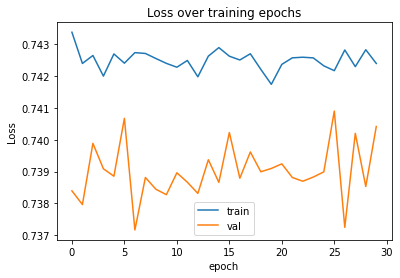

In [17]:
plt.plot(history['train'])
plt.plot(history['val'])
plt.ylabel('Loss')
plt.xlabel('epoch')
plt.title('Loss over training epochs')
plt.legend(['train','val'])
plt.show()

## 検証

In [18]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

import warnings
warnings.simplefilter("ignore")

08_36_0_2


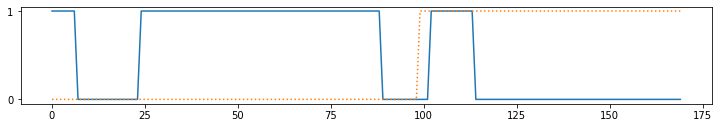

02_02_2_4


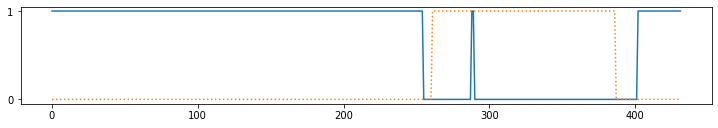

02_01_4_17


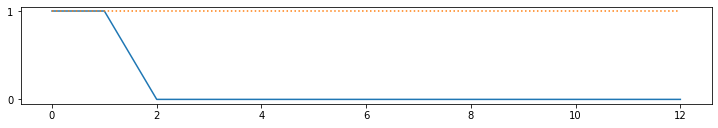

02_05_0_4


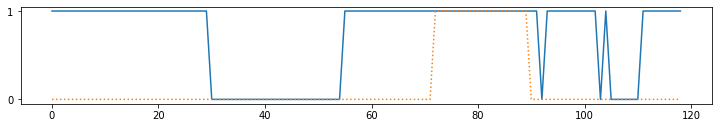

08_31_2_4


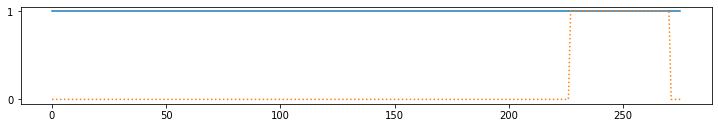

09_09_1_2


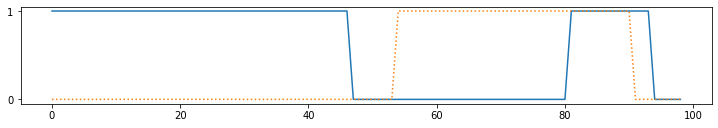

08_23_0_1


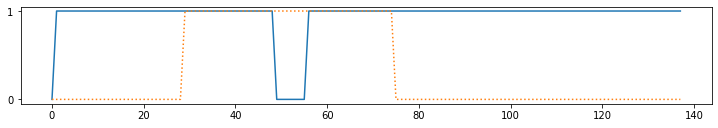

08_17_0_3


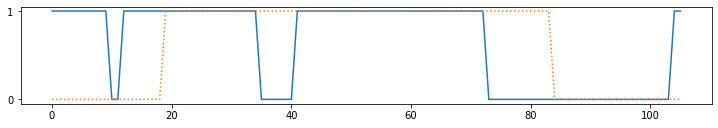

08_16_0_1


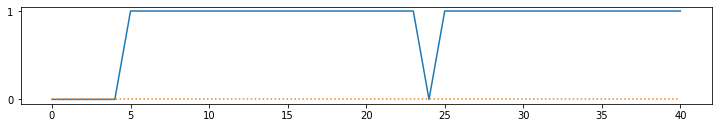

08_35_0_2


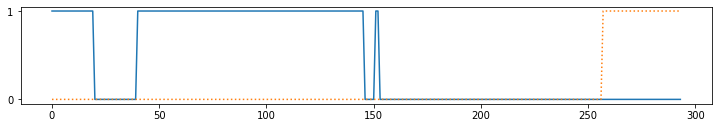

08_20_0_3


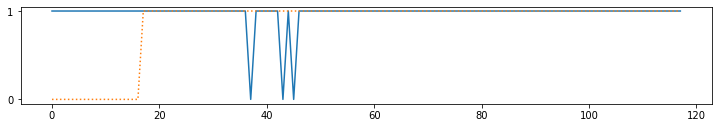

02_12_4_7


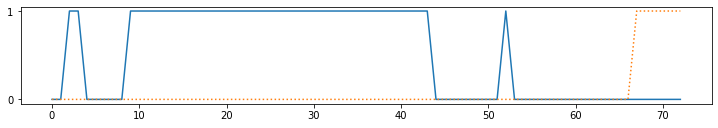

09_04_1_3


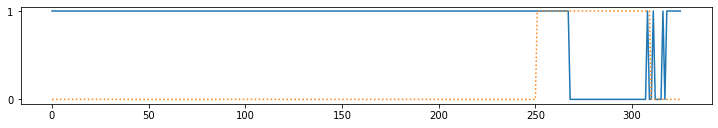

09_02_5_7


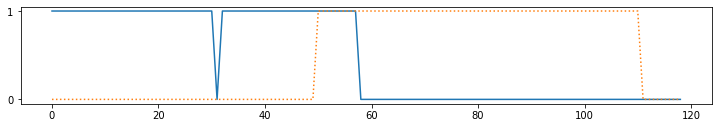

08_18_0_3


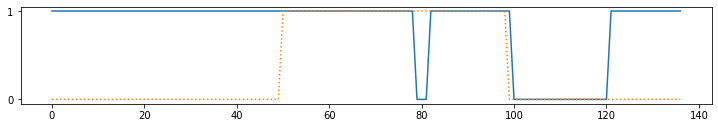

08_26_2_10


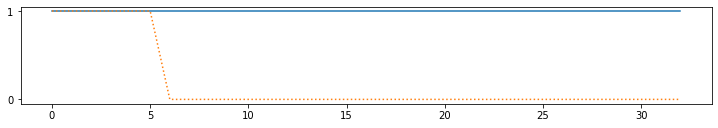

09_07_1_3


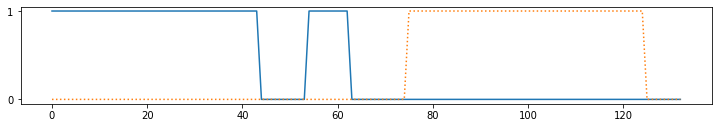

08_27_4_11


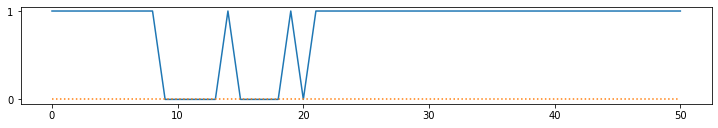

08_38_0_2


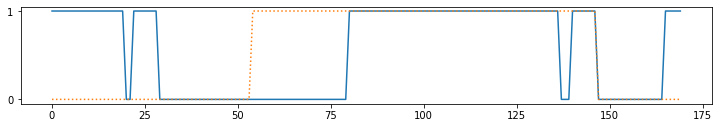

08_32_0_1


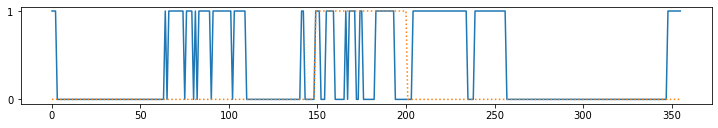

08_06_0_5


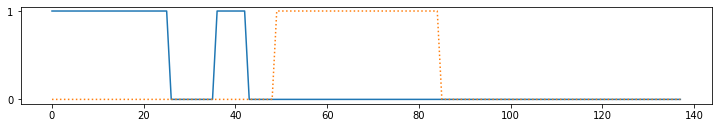

02_18_1_10


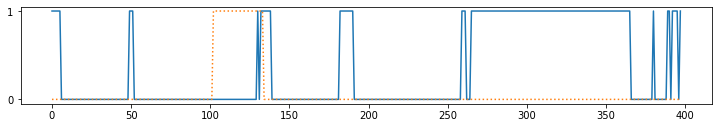

08_14_2_3


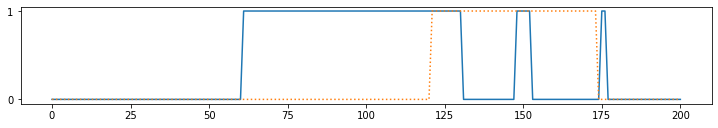

02_19_0_4


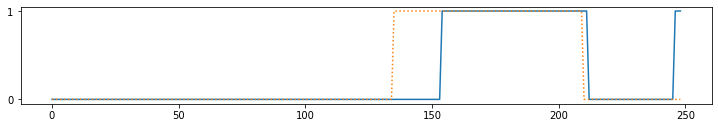

09_03_0_3


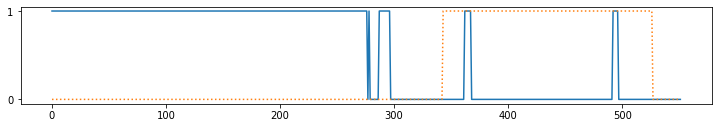

08_22_0_4


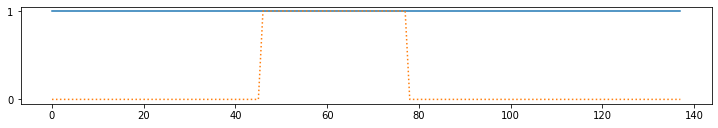

08_12_2_3


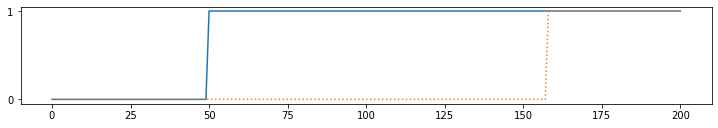

08_09_0_2


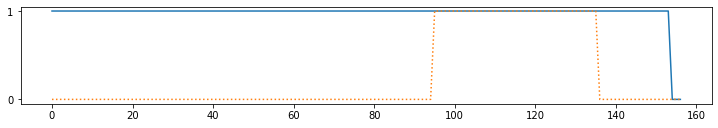

02_21_6_10


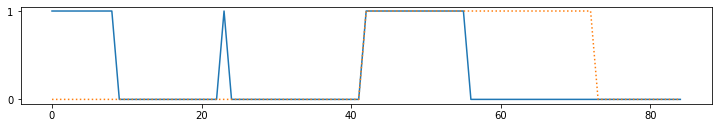

08_41_1_3


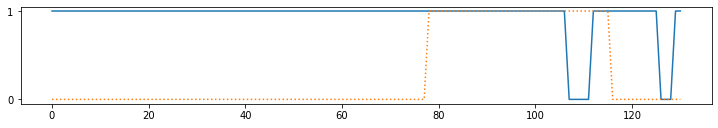

08_07_3_6


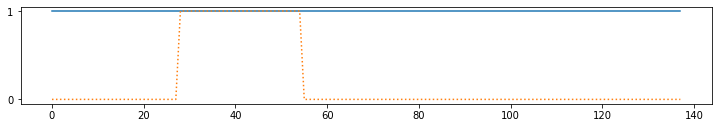

09_08_0_3


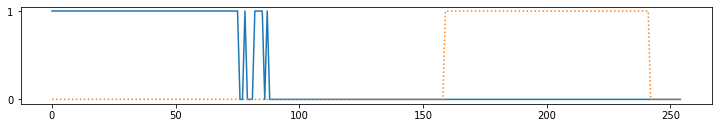

02_02_1_2


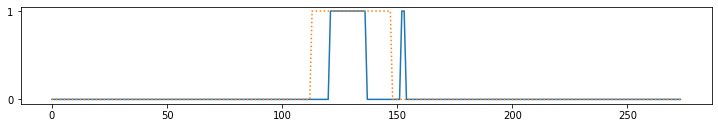

08_08_0_2


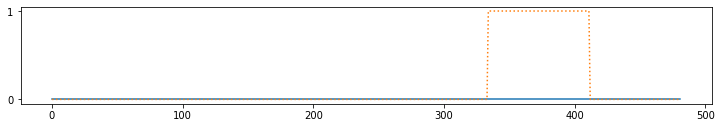

08_11_0_2


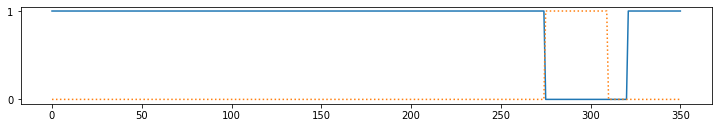

08_25_2_9


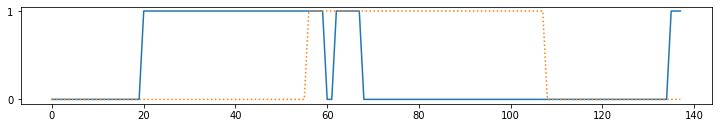

02_07_1_8


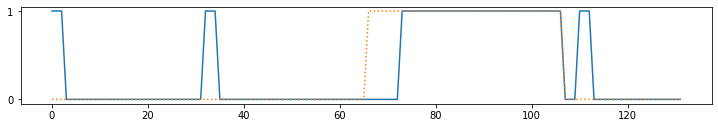

08_01_3_6


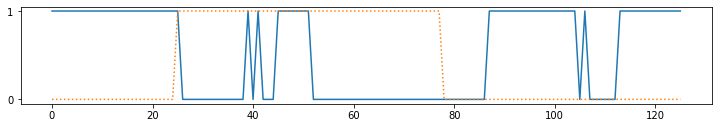

02_13_1_9


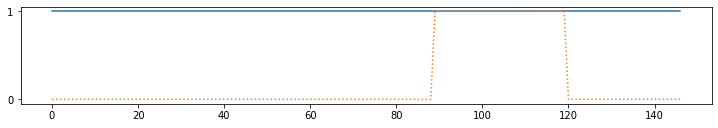

02_11_2_6


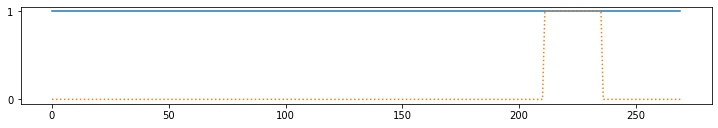

09_05_3_13


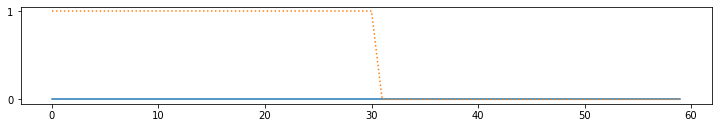

08_34_0_2


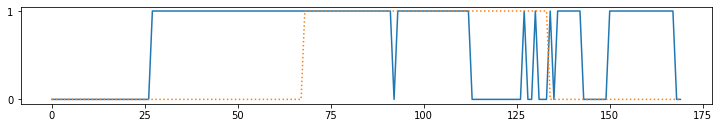

08_21_0_4


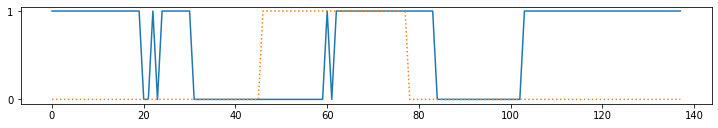

08_15_1_3


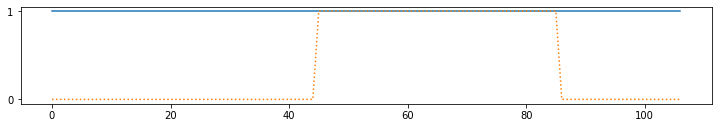

02_10_4_13


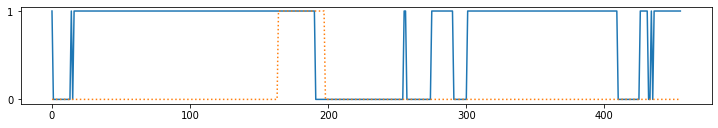

08_05_1_2


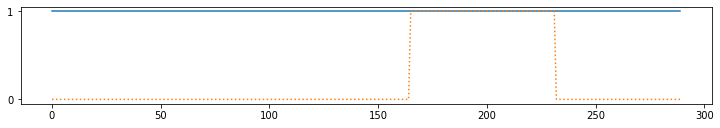

02_20_2_8


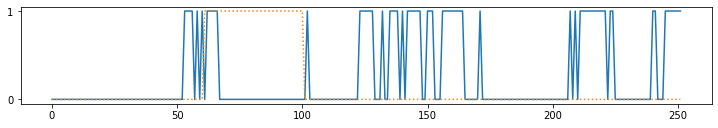

08_28_4_11


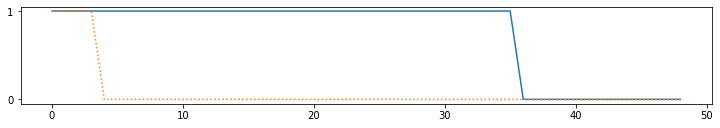

08_04_2_3


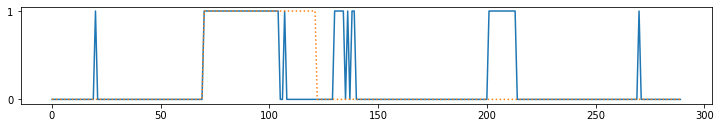

In [19]:
acc_train = []
prcs_train = []
rcl_train = []
f1_train =[]

model.eval()
with torch.no_grad():
    for key in train_keys:
        x_lst = x_dict_std[key]
        y_lst = y_dict_std[key]
        
        if 1 not in y_lst:
            continue

        x, _ = create_sequence(x_lst, y_lst, **config)
        x = torch.Tensor(x).float().to(device)

        pred = model(x)
        pred = pred.max(1)[1]
        pred = pred.cpu().numpy()

        y_lst = y_lst[SEQ_LEN - 1:]
            
        acc_train.append(accuracy_score(pred, y_lst))
        prcs_train.append(precision_score(pred, y_lst))
        rcl_train.append(recall_score(pred, y_lst))
        f1_train.append(f1_score(pred, y_lst))
            
        print(key)
        plt.figure(figsize=(10, 1.5))
        # plt.rcParams["font.size"] = 20
        # plt.rcParams["font.family"] = 'Times New Roman'
        plt.plot(pred, label='pred')
        plt.plot(y_lst, linestyle=':', label='ground truth')
        plt.ylim((-0.05, 1.05))
        plt.yticks([0, 1])
        plt.subplots_adjust(left=0.04, right=1, bottom=0.1, top=1)

        plt.show()

In [20]:
print('accuracy: {:.3f}'.format(np.mean(acc_train)))
print('precision: {:.3f}'.format(np.mean(prcs_train)))
print('recall: {:.3f}'.format(np.mean(rcl_train)))
print('f1_score: {:.3f}'.format(np.mean(f1_train)))

accuracy: 0.397
precision: 0.505
recall: 0.258
f1_score: 0.289


02_22_0_5


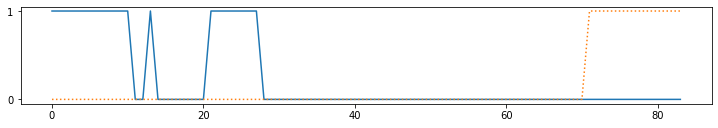

08_02_1_2


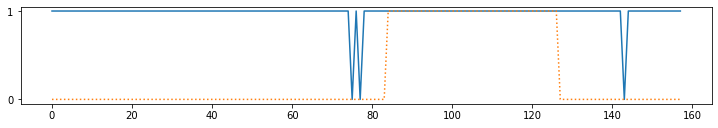

08_33_0_7


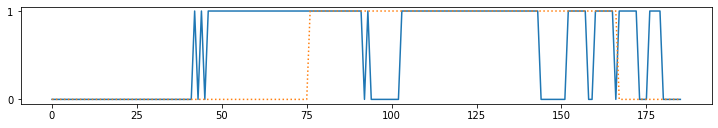

08_19_1_2


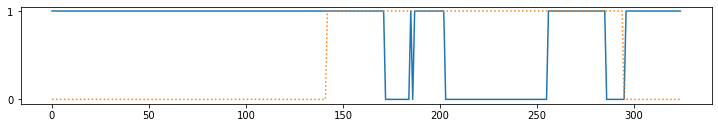

02_03_1_4


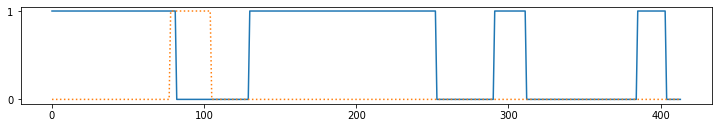

08_40_0_1


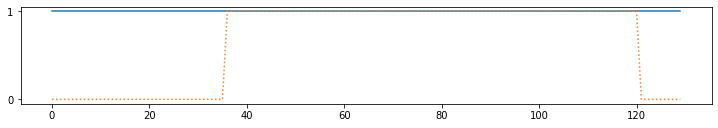

08_10_1_3


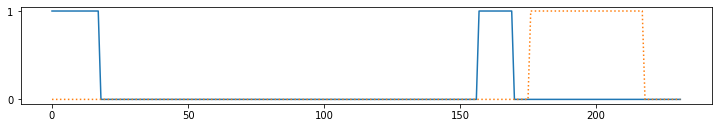

09_06_0_2


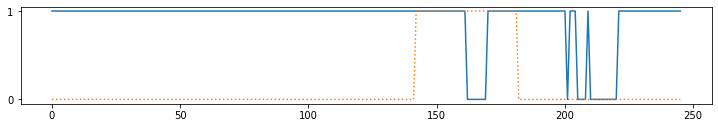

02_23_3_14


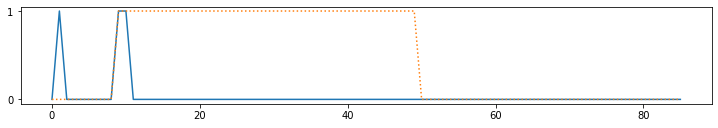

08_29_2_5


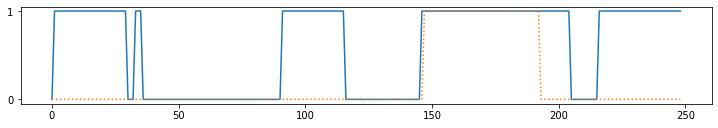

08_03_4_5


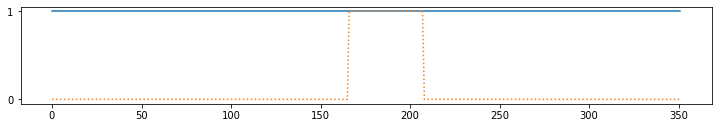

02_09_0_9


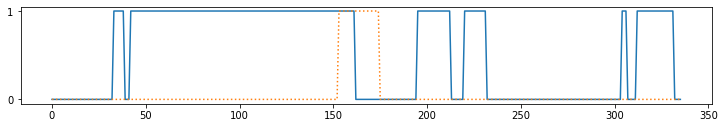

08_13_0_4


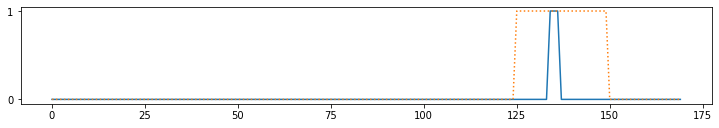

09_01_0_5


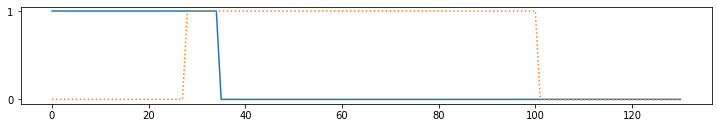

02_15_9_21


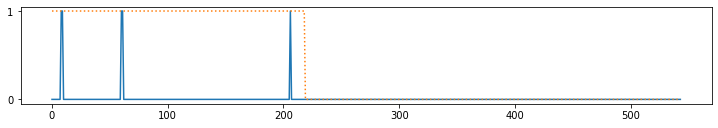

08_37_2_3


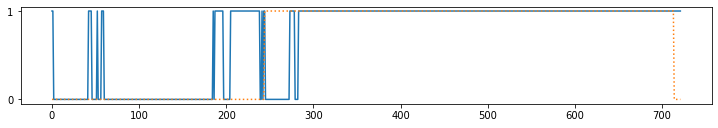

In [21]:
acc_test = []
prcs_test = []
rcl_test = []
f1_test =[]

model.eval()
with torch.no_grad():
    for key in test_keys:
        x_lst = x_dict_std[key]
        y_lst = y_dict_std[key]
        
        if 1 not in y_lst:
            continue

        x, _ = create_sequence(x_lst, y_lst, **config)
        x = torch.Tensor(x).float().to(device)

        pred = model(x)
        pred = pred.max(1)[1]
        pred = pred.cpu().numpy()

        y_lst = y_lst[SEQ_LEN - 1:]
            
        acc_test.append(accuracy_score(pred, y_lst))
        prcs_test.append(precision_score(pred, y_lst))
        rcl_test.append(recall_score(pred, y_lst))
        f1_test.append(f1_score(pred, y_lst))
            
        print(key)
        plt.figure(figsize=(10, 1.5))
        # plt.rcParams["font.size"] = 20
        # plt.rcParams["font.family"] = 'Times New Roman'
        plt.plot(pred, label='pred')
        plt.plot(y_lst, linestyle=':', label='ground truth')
        plt.ylim((-0.05, 1.05))
        plt.yticks([0, 1])
        plt.subplots_adjust(left=0.04, right=1, bottom=0.1, top=1)

        plt.show()

In [22]:
print('accuracy: {:.3f}'.format(np.mean(acc_test)))
print('precision: {:.3f}'.format(np.mean(prcs_test)))
print('recall: {:.3f}'.format(np.mean(rcl_test)))
print('f1_score: {:.3f}'.format(np.mean(f1_test)))

accuracy: 0.502
precision: 0.491
recall: 0.390
f1_score: 0.295


In [23]:
path = f'{common.root}/model/pass_model_cnn.pth'
torch.save(model, path)